In [ ]:
from google.colab import drive # Mount the google drive for data loading
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Import some related dependencies
1.   Numpy: a package for array transformation
2.   Scipy: a package for loading data with (.mat) format
3.   Matplotlib: a package for data visualization
4.   Skearn: a package including many machine learning approaches
5.   Tensorflow: a package for neural networks modeling
6.   Keras: a package for neural networks modeling which is established on Tensorflow

In [ ]:
import numpy as np #helps for array operation
import scipy.io as sio #helps to read the data
import matplotlib.pyplot as plt #helps with graphical plots
from sklearn.preprocessing import OneHotEncoder #helps for label one-hot encoding
import tensorflow as tf #helps for ANN model construction
import keras #helps for ANN model construction
from keras.datasets import cifar10 #helps for loading cifar10 dataset

# Test the GPU

In [ ]:
device_name = tf.test.gpu_device_name()  # Current GPU name 
if device_name != '/device:GPU:0':       # Test if the GPU exists
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name)) 

Found GPU at: /device:GPU:0


# Visualizaiton of raw images

In [ ]:
(trainX,_), (_, _) = cifar10.load_data() # Download the Cifar10 data online. Only the training dataset will be used for GAN training.
#trainX = sio.loadmat('/content/drive/MyDrive/lab_code/Cifar10.mat')['trainX'] # Or you can load the Cifar10.mat data from local

In [ ]:
trainX.shape

(50000, 32, 32, 3)

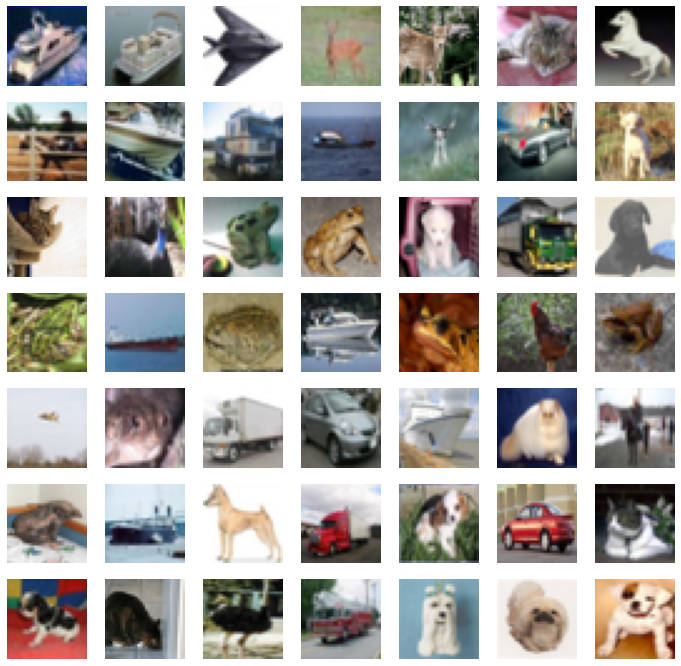

In [ ]:
#trainX = trainX  	                                                        # Scale generated images from [-1,1] to [0,1]
ix = np.random.randint(0, trainX.shape[0], 7*7)				 		                    # Choose 7*7 random index
X = trainX[ix]		                                                            # Choose 7*7 samples as the selected index
plt.figure(figsize=(12,12))                                                   # Set the whole figure size 
for i in range(7 * 7):           	                                            # Plot images
  plt.subplot(7, 7, 1 + i)                                                    # Define subplot
  plt.axis('off')									                                            # Turn off axis, only show the generated images
  plt.imshow(X[i]/255)                                                            # Show the images
plt.show()

#Define a discriminator
The discriminator is used to try to discriminate the generated samples and real samples.

In [ ]:
def define_discriminator(in_shape=(32,32,3)):   																	# A function with a parameter of input shape 
	model = keras.models.Sequential()																								# Sequential model in keras to add layers
	model.add(keras.layers.Conv2D(64, (3,3), strides=(1,1),padding='same', input_shape=in_shape)) # Convolutional layer with 64 filters. Kernel size is (3,3), stride is (1,1)
	model.add(keras.layers.LeakyReLU(alpha=0.2))                                    # Leaky ReLU activation function with a slope of 0.2
	model.add(keras.layers.Conv2D(128, (3,3), strides=(2,2), padding='same'))       # Convolutional layer with 128 filters. Kernel size is (3,3), stride is (2,2)
	model.add(keras.layers.LeakyReLU(alpha=0.2))                                    # Leaky ReLU activation function with a slope of 0.2
	model.add(keras.layers.Conv2D(128, (3,3), strides=(2,2), padding='same'))       # Convolutional layer with 128 filters. Kernel size is (3,3), stride is (2,2)
	model.add(keras.layers.LeakyReLU(alpha=0.2))                                    # Leaky ReLU activation function with a slope of 0.2
	model.add(keras.layers.Conv2D(256, (3,3), strides=(2,2), padding='same'))       # Convolutional layer with 256 filters. Kernel size is (3,3), stride is (2,2)
	model.add(keras.layers.LeakyReLU(alpha=0.2))                                    # Leaky ReLU activation function with a slope of 0.2
	model.add(keras.layers.Flatten())             																	# Reshape the previous output to be a one-dimension vector
	model.add(keras.layers.Dropout(0.4))                                            # Alleviate overfitting with a dropout layer 
	model.add(keras.layers.Dense(2, activation='softmax')) 													# Classifier. Real is [0, 1], fake is [1, 0] 
	opt = tf.keras.optimizers.Adam(lr=0.0002, beta_1=0.5)                           # Set the learning rate of Adam optimizer
	model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])  # Compile the model with the optimizer, a loss of binary crossentropy, and an accuracy metric
	model.summary()																																	# Summary the discriminator model
	return model

#Define a generator
The generator is used to generate fake samples

In [ ]:
def define_generator(latent_dim):                                                   # A function with a parameter of input dim 
	model = keras.models.Sequential() 																								# Sequential model in keras to add layers
	model.add(keras.layers.Dense(256 * 4 * 4, input_dim=latent_dim))                  # A fully connected layer to map the input_dim to a shape of 256*4*4
	model.add(keras.layers.LeakyReLU(alpha=0.2))																			# Leaky ReLU activation function with a slope of 0.2
	model.add(keras.layers.Reshape((4, 4, 256)))																			# Reshape the vector to be a 3-dimension image
	model.add(keras.layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))# Transposed convolution layer with 128 filters. Kernel size is (4,4), stride is (2,2)
	model.add(keras.layers.LeakyReLU(alpha=0.2))																			# Leaky ReLU activation function with a slope of 0.2
	model.add(keras.layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))# Transposed convolution layer with 128 filters. Kernel size is (4,4), stride is (2,2)
	model.add(keras.layers.LeakyReLU(alpha=0.2))																			# Leaky ReLU activation function with a slope of 0.2
	model.add(keras.layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))# Transposed convolution layer with 128 filters. Kernel size is (4,4), stride is (2,2)
	model.add(keras.layers.LeakyReLU(alpha=0.2))																			# Leaky ReLU activation function with a slope of 0.2
	model.add(keras.layers.Conv2D(3, (3,3), strides=(1,1), activation='tanh', padding='same')) # Convolutional layer with 3 filters. Kernel size is (3,3), stride is (1,1), activation function is tanh (-1,1). The final output shape is 32x32x3, which is like an image.
	model.summary()																																		# Summary the generator model
	return model

#Define the GAN model based on discriminator and generator
The weights in discriminator are fixed, and GAN model only updates the weights in generator.

In [ ]:
def define_gan(g_model, d_model):												   # A function with two parameters: discriminator model and generator model 
	d_model.trainable = False                                # Make weights in the discriminator not trainable
	model = keras.models.Sequential()                        # Sequential model in keras to add the two models
	model.add(g_model)                                       # Add generator
	model.add(d_model)																			 # Add the discriminator
	model.summary()																					 # Summary the GAN model
	opt = tf.keras.optimizers.Adam(lr=0.0002, beta_1=0.5)    # Set the learning rate of Adam optimizer            
	model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy']) # Compile the model with the optimizer, a loss of binary crossentropy, and an accuracy metric
	return model

# Load the real images

1.   Import the Cifar10.mat data
2.   Take one sample every ten samples
3.   Convert data from unsigned ints to floats
4.   Normalize the data [0, 255] to an interval of [-1, 1]

In [ ]:
def load_real_samples():                                                              # Define a function of loading real samples
	X = trainX[::10]																														# Load the Cifar10.mat data and take one sample every ten samples
	X = X.astype('float32')                                                        # Convert data from unsigned ints to floats
	X = (X - 127.5) / 127.5                               															# Scale data from [0,255] to [-1,1]
	return X

# Select real images and define labels

In [ ]:
def generate_real_samples(dataset, n_samples):                  	   # A function with two parameters: data and the number of samples in a batch
	ix = np.random.randint(0, dataset.shape[0], n_samples)				 		 # Choose n_samples random instances
	X = dataset[ix]																									
	y = np.repeat(np.asarray([0, 1]).reshape(1, 2), n_samples, axis=0) # Define the labels of real images using [0, 1]
	return X, y

# Generate input for the generator

In [ ]:
def generate_latent_points(latent_dim, n_samples):    # A function with two parameters: input dimension and the number of generated samples in a batch
	x_input = np.random.randn(latent_dim * n_samples) 	# Generate random noise vector with a length of latent_dim * n_samples
	x_input = x_input.reshape(n_samples, latent_dim)    # Reshape into a batch of inputs for the generator
	return x_input

# Generate fake samples using the generator

In [ ]:
def generate_fake_samples(g_model, latent_dim, n_samples):           # A function with three parameters: generator model, input dimension and the number of generated samples in a batch
	x_input = generate_latent_points(latent_dim, n_samples)            # Generate input for the generator
	X = g_model.predict(x_input)																	 	   # predict outputs, i.e., generate fake samples 
	y = np.repeat(np.asarray([1, 0]).reshape(1, 2), n_samples, axis=0) # Define the labels of fake images using [1, 0]
	return X, y

# Display the generated images

In [ ]:
def plot_generate(examples, n = 7): # A function with three parameters: generated images, the number of images n^2 once displayed. Default n is 7, you can change it.
	plt.figure(figsize=(12,12))       # Set the whole figure size 
	examples = (examples + 1) / 2.0  	# Scale generated images from [-1,1] to [0,1]
	for i in range(n * n):           	# Plot images
		plt.subplot(n, n, 1 + i)        # Define subplot
		plt.axis('off')									# Turn off axis, only show the generated images
		plt.imshow(examples[i])         # Show the images
	plt.show()
	plt.close()

# Evaluate the discriminator


1.   Evaluate the classification accuracy for both real samples and fakes samples
2.   Save generator model




In [ ]:
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, n_samples=128):  # A function with six parameters: current training epoch, current generator model, current discriminator model, real dataset, input dimension for generator, the number of samples in a batch (default 128)
	X_real, y_real = generate_real_samples(dataset, n_samples)                      	# Prepare real samples
	_, acc_real = d_model.evaluate(X_real, y_real, verbose=0)													# Evaluate discriminator on real examples
	x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)						# Prepare fake examples
	_, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)													# Evaluate discriminator on fake examples
	print(f'>Accuracy real: {acc_real*100}%, fake: {acc_fake*100}%')      						# Summarize discriminator performance	
	plot_generate(x_fake)																															# Plot the generated images
	filename = 'generator_model_%d.h5' % (epoch+1)																	  # Save the generator model
	g_model.save(filename)

# Train the generator and discriminator


1.   Train discriminator using a half batch of real images 
2.   Train discriminator using a half batch of fake images 
3.   Generate a batch of fake samples and define their labels as real images (i.e., [0, 1])
4.   Train generator using a batch of fake images



In [ ]:
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=500, n_batch=128): # Define the training model, n_epochs = 500, batch size = 128.
	bat_per_epo = int(dataset.shape[0] / n_batch)                                         # Calculate the number of batches in this cifar dataset
	half_batch = int(n_batch / 2)																													# Compute a half of batch
	for i in range(n_epochs): 																														# A loop of model training for n_epochs
		for j in range(bat_per_epo):																												# A loop of model training for bat_per_epo times in each epoch
			X_real, y_real = generate_real_samples(dataset, half_batch)												# Get randomly selected 'real' images of half batch
			d_loss1, _ = d_model.train_on_batch(X_real, y_real)																# Train discriminator model weights using real images
			X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)						# Generate 'fake' images of half batch						
			d_loss2, _ = d_model.train_on_batch(X_fake, y_fake)														  	# Train discriminator model weights using fake images
			X_gan = generate_latent_points(latent_dim, n_batch)																# Prepare input of a batch for the generator
			y_gan = np.repeat(np.asarray([0,1]).reshape(1,2), n_batch, axis=0)						  	# Define their labels as real images (i.e., [0, 1]) to generate more realistic images
			g_loss, _ = gan_model.train_on_batch(X_gan, y_gan)																# Train generator model weights using fake images												
			print('>%d, %d/%d, d1=%.3f, d2=%.3f g=%.3f' % (i+1, j+1, bat_per_epo, d_loss1, d_loss2, g_loss))  			# Summarize loss on this batch
		if (i+1) % 10 == 0:																																	# Evaluate the model performance every 10 epochs
			summarize_performance(i, g_model, d_model, dataset, latent_dim)

# Model training and visualization

In [ ]:
dataset = load_real_samples()                        # Load real images
dataset.shape

(5000, 32, 32, 3)

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_25 (Conv2D)          (None, 32, 32, 64)        1792      
                                                                 
 leaky_re_lu_40 (LeakyReLU)  (None, 32, 32, 64)        0         
                                                                 
 conv2d_26 (Conv2D)          (None, 16, 16, 128)       73856     
                                                                 
 leaky_re_lu_41 (LeakyReLU)  (None, 16, 16, 128)       0         
                                                                 
 conv2d_27 (Conv2D)          (None, 8, 8, 128)         147584    
                                                                 
 leaky_re_lu_42 (LeakyReLU)  (None, 8, 8, 128)         0         
                                                                 
 conv2d_28 (Conv2D)          (None, 4, 4, 256)       

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 4096)              413696    
                                                                 
 leaky_re_lu_44 (LeakyReLU)  (None, 4096)              0         
                                                                 
 reshape_5 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_15 (Conv2D  (None, 8, 8, 128)        524416    
 Transpose)                                                      
                                                                 
 leaky_re_lu_45 (LeakyReLU)  (None, 8, 8, 128)         0         
                                                                 
 conv2d_transpose_16 (Conv2D  (None, 16, 16, 128)      262272    
 Transpose)                                                      
          

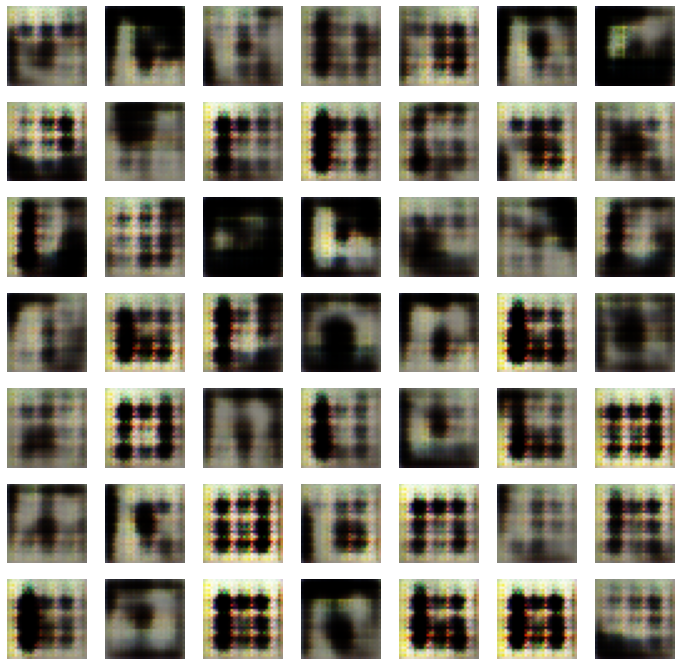

>11, 1/39, d1=0.508, d2=0.394 g=1.844
>11, 2/39, d1=0.397, d2=0.448 g=1.771
>11, 3/39, d1=0.431, d2=0.753 g=1.412
>11, 4/39, d1=0.438, d2=1.409 g=1.503
>11, 5/39, d1=0.986, d2=0.688 g=1.888
>11, 6/39, d1=0.796, d2=0.393 g=2.034
>11, 7/39, d1=0.908, d2=0.428 g=1.906
>11, 8/39, d1=0.929, d2=0.491 g=2.184
>11, 9/39, d1=0.794, d2=0.318 g=2.027
>11, 10/39, d1=0.767, d2=0.423 g=1.870
>11, 11/39, d1=0.623, d2=0.387 g=1.826
>11, 12/39, d1=0.585, d2=0.407 g=2.000
>11, 13/39, d1=0.642, d2=0.388 g=1.917
>11, 14/39, d1=0.626, d2=0.448 g=1.812
>11, 15/39, d1=0.553, d2=0.384 g=2.016
>11, 16/39, d1=0.491, d2=0.301 g=1.876
>11, 17/39, d1=0.564, d2=0.304 g=1.847
>11, 18/39, d1=0.516, d2=0.360 g=1.792
>11, 19/39, d1=0.464, d2=0.360 g=1.786
>11, 20/39, d1=0.361, d2=0.308 g=1.819
>11, 21/39, d1=0.508, d2=0.334 g=1.910
>11, 22/39, d1=0.400, d2=0.376 g=1.884
>11, 23/39, d1=0.445, d2=0.340 g=1.788
>11, 24/39, d1=0.452, d2=0.443 g=1.528
>11, 25/39, d1=0.454, d2=0.621 g=1.448
>11, 26/39, d1=0.630, d2=0.791 g=1

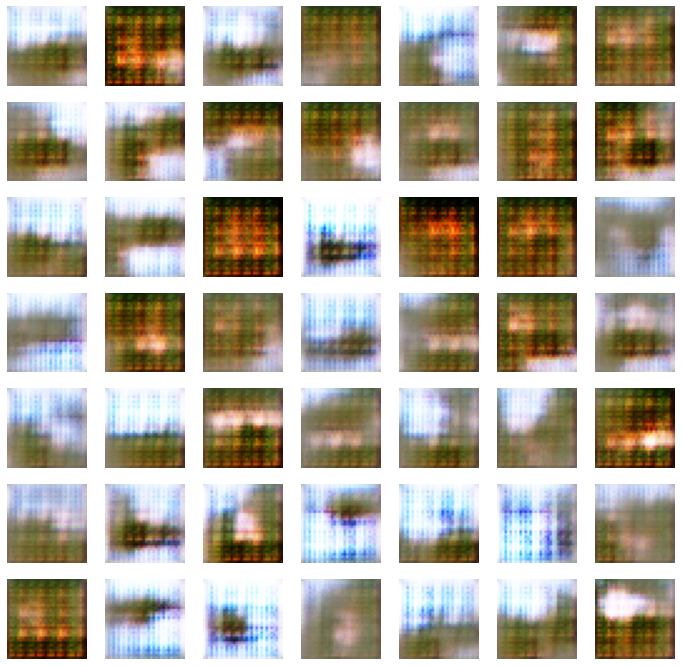

>21, 1/39, d1=0.559, d2=0.536 g=1.043
>21, 2/39, d1=0.599, d2=0.532 g=0.992
>21, 3/39, d1=0.544, d2=0.636 g=0.964
>21, 4/39, d1=0.526, d2=0.578 g=0.952
>21, 5/39, d1=0.558, d2=0.625 g=0.936
>21, 6/39, d1=0.535, d2=0.697 g=0.953
>21, 7/39, d1=0.463, d2=0.600 g=1.048
>21, 8/39, d1=0.506, d2=0.560 g=1.120
>21, 9/39, d1=0.624, d2=0.510 g=1.138
>21, 10/39, d1=0.564, d2=0.527 g=1.236
>21, 11/39, d1=0.502, d2=0.457 g=1.238
>21, 12/39, d1=0.516, d2=0.472 g=1.338
>21, 13/39, d1=0.492, d2=0.421 g=1.406
>21, 14/39, d1=0.518, d2=0.365 g=1.356
>21, 15/39, d1=0.475, d2=0.480 g=1.350
>21, 16/39, d1=0.473, d2=0.485 g=1.332
>21, 17/39, d1=0.618, d2=0.617 g=1.135
>21, 18/39, d1=0.569, d2=0.936 g=1.155
>21, 19/39, d1=0.698, d2=0.630 g=1.362
>21, 20/39, d1=0.911, d2=0.525 g=1.241
>21, 21/39, d1=0.876, d2=0.581 g=1.199
>21, 22/39, d1=0.704, d2=0.589 g=1.177
>21, 23/39, d1=0.951, d2=0.627 g=1.118
>21, 24/39, d1=0.654, d2=0.591 g=1.155
>21, 25/39, d1=0.656, d2=0.587 g=1.171
>21, 26/39, d1=0.794, d2=0.603 g=1

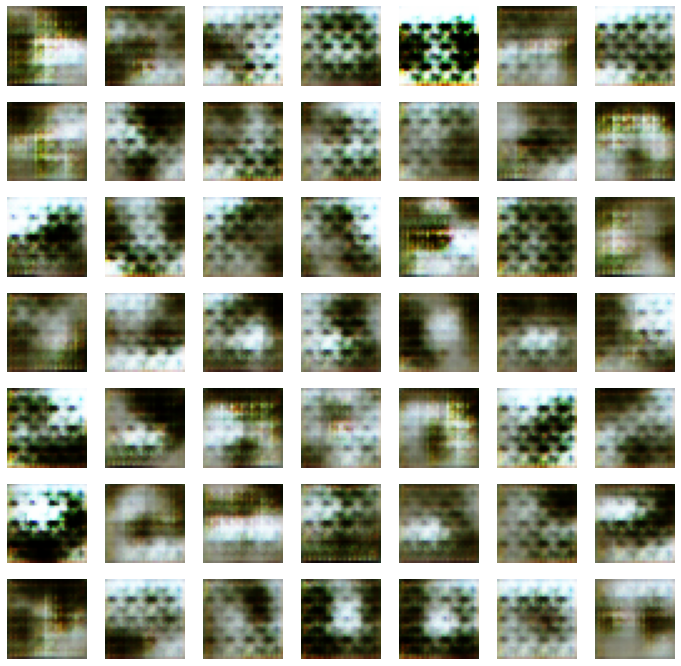

>31, 1/39, d1=0.729, d2=0.687 g=0.996
>31, 2/39, d1=0.849, d2=0.747 g=0.927
>31, 3/39, d1=0.835, d2=0.679 g=0.930
>31, 4/39, d1=0.716, d2=0.631 g=0.939
>31, 5/39, d1=0.616, d2=0.625 g=0.935
>31, 6/39, d1=0.698, d2=0.637 g=0.975
>31, 7/39, d1=0.704, d2=0.591 g=1.046
>31, 8/39, d1=0.682, d2=0.597 g=1.102
>31, 9/39, d1=0.793, d2=0.584 g=1.064
>31, 10/39, d1=0.615, d2=0.594 g=1.095
>31, 11/39, d1=0.656, d2=0.557 g=1.147
>31, 12/39, d1=0.591, d2=0.553 g=1.011
>31, 13/39, d1=0.619, d2=0.639 g=1.019
>31, 14/39, d1=0.629, d2=0.577 g=1.037
>31, 15/39, d1=0.645, d2=0.601 g=1.034
>31, 16/39, d1=0.628, d2=0.535 g=1.064
>31, 17/39, d1=0.685, d2=0.642 g=1.032
>31, 18/39, d1=0.607, d2=0.546 g=1.111
>31, 19/39, d1=0.711, d2=0.537 g=1.083
>31, 20/39, d1=0.683, d2=0.647 g=1.083
>31, 21/39, d1=0.675, d2=0.571 g=1.103
>31, 22/39, d1=0.647, d2=0.513 g=1.117
>31, 23/39, d1=0.630, d2=0.514 g=1.116
>31, 24/39, d1=0.614, d2=0.533 g=1.085
>31, 25/39, d1=0.467, d2=0.528 g=1.146
>31, 26/39, d1=0.572, d2=0.570 g=1

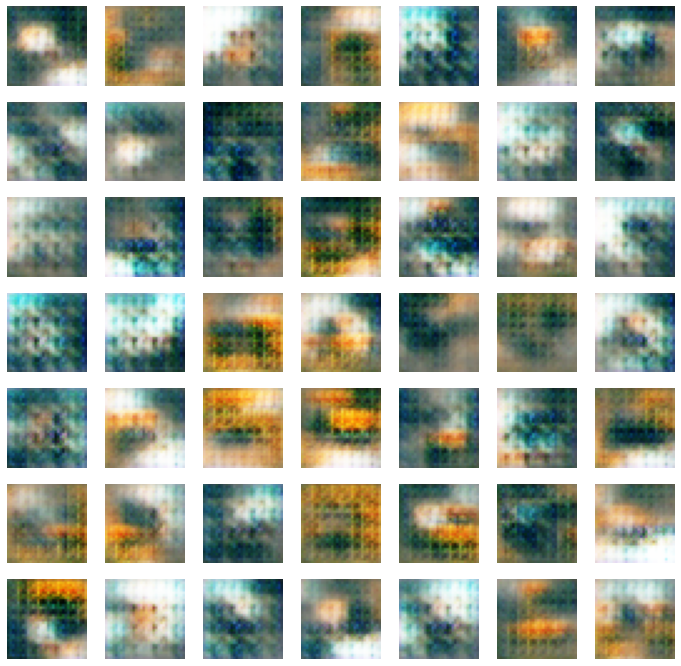

>41, 1/39, d1=0.676, d2=0.610 g=0.967
>41, 2/39, d1=0.746, d2=0.649 g=0.944
>41, 3/39, d1=0.615, d2=0.626 g=0.943
>41, 4/39, d1=0.593, d2=0.596 g=0.992
>41, 5/39, d1=0.607, d2=0.581 g=0.983
>41, 6/39, d1=0.564, d2=0.597 g=0.965
>41, 7/39, d1=0.560, d2=0.593 g=0.985
>41, 8/39, d1=0.544, d2=0.594 g=0.980
>41, 9/39, d1=0.556, d2=0.602 g=0.907
>41, 10/39, d1=0.507, d2=0.660 g=0.878
>41, 11/39, d1=0.488, d2=0.675 g=0.859
>41, 12/39, d1=0.534, d2=0.712 g=0.865
>41, 13/39, d1=0.523, d2=0.722 g=0.896
>41, 14/39, d1=0.626, d2=0.710 g=0.884
>41, 15/39, d1=0.617, d2=0.710 g=0.875
>41, 16/39, d1=0.568, d2=0.684 g=0.878
>41, 17/39, d1=0.726, d2=0.689 g=0.908
>41, 18/39, d1=0.682, d2=0.726 g=0.914
>41, 19/39, d1=0.583, d2=0.638 g=0.946
>41, 20/39, d1=0.673, d2=0.586 g=0.998
>41, 21/39, d1=0.645, d2=0.563 g=0.946
>41, 22/39, d1=0.602, d2=0.586 g=1.042
>41, 23/39, d1=0.636, d2=0.520 g=1.072
>41, 24/39, d1=0.509, d2=0.539 g=1.079
>41, 25/39, d1=0.572, d2=0.520 g=1.068
>41, 26/39, d1=0.509, d2=0.558 g=1

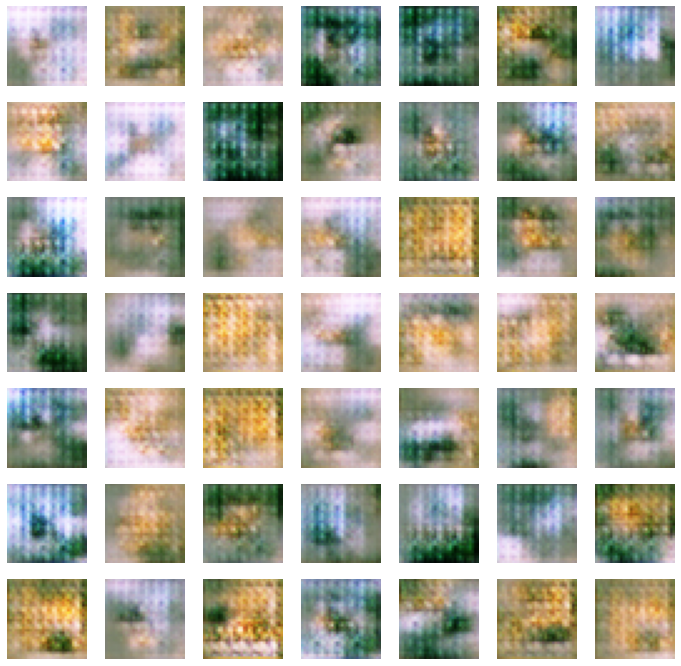

>51, 1/39, d1=0.269, d2=0.471 g=1.313
>51, 2/39, d1=0.322, d2=0.458 g=1.280
>51, 3/39, d1=0.304, d2=0.512 g=1.350
>51, 4/39, d1=0.347, d2=0.572 g=1.371
>51, 5/39, d1=0.393, d2=0.461 g=1.406
>51, 6/39, d1=0.530, d2=0.568 g=1.321
>51, 7/39, d1=0.564, d2=0.690 g=1.457
>51, 8/39, d1=0.631, d2=0.550 g=1.384
>51, 9/39, d1=0.577, d2=0.571 g=1.325
>51, 10/39, d1=0.713, d2=0.720 g=1.330
>51, 11/39, d1=0.675, d2=0.739 g=1.508
>51, 12/39, d1=0.980, d2=0.459 g=1.395
>51, 13/39, d1=0.732, d2=0.613 g=1.442
>51, 14/39, d1=0.727, d2=0.426 g=1.516
>51, 15/39, d1=0.584, d2=0.544 g=1.654
>51, 16/39, d1=0.604, d2=0.414 g=1.719
>51, 17/39, d1=0.556, d2=0.377 g=1.607
>51, 18/39, d1=0.443, d2=0.446 g=1.499
>51, 19/39, d1=0.506, d2=0.418 g=1.430
>51, 20/39, d1=0.409, d2=0.570 g=1.594
>51, 21/39, d1=0.583, d2=0.545 g=1.602
>51, 22/39, d1=0.751, d2=0.438 g=1.526
>51, 23/39, d1=0.804, d2=0.548 g=1.581
>51, 24/39, d1=0.837, d2=0.502 g=1.536
>51, 25/39, d1=0.744, d2=0.432 g=1.497
>51, 26/39, d1=0.802, d2=0.444 g=1

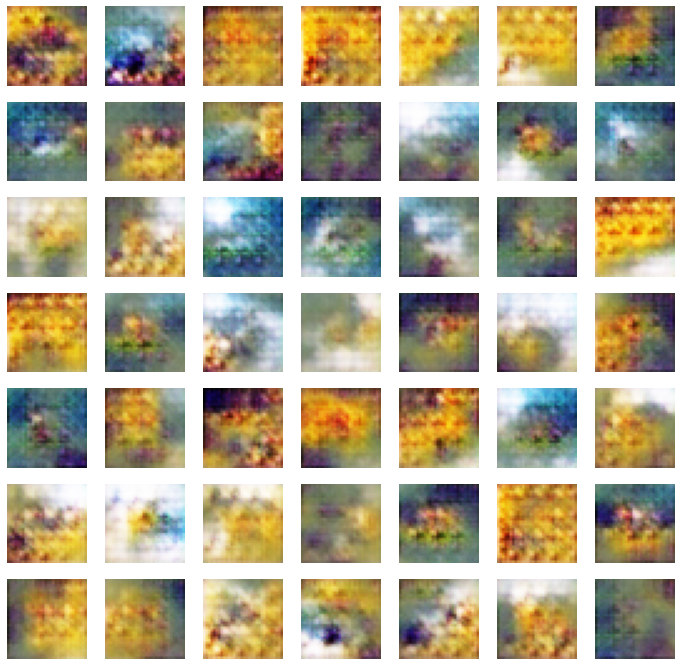

>61, 1/39, d1=0.455, d2=0.477 g=1.171
>61, 2/39, d1=0.360, d2=0.576 g=1.209
>61, 3/39, d1=0.307, d2=0.481 g=1.289
>61, 4/39, d1=0.321, d2=0.554 g=1.114
>61, 5/39, d1=0.296, d2=0.545 g=1.089
>61, 6/39, d1=0.361, d2=0.633 g=1.100
>61, 7/39, d1=0.398, d2=0.727 g=1.051
>61, 8/39, d1=0.432, d2=0.598 g=1.073
>61, 9/39, d1=0.435, d2=0.613 g=1.123
>61, 10/39, d1=0.533, d2=0.590 g=1.082
>61, 11/39, d1=0.551, d2=0.571 g=1.172
>61, 12/39, d1=0.606, d2=0.603 g=1.159
>61, 13/39, d1=0.594, d2=0.575 g=1.196
>61, 14/39, d1=0.857, d2=0.574 g=1.167
>61, 15/39, d1=0.696, d2=0.699 g=1.105
>61, 16/39, d1=0.610, d2=0.607 g=1.132
>61, 17/39, d1=0.701, d2=0.516 g=1.186
>61, 18/39, d1=0.727, d2=0.569 g=1.182
>61, 19/39, d1=0.773, d2=0.541 g=1.170
>61, 20/39, d1=0.690, d2=0.524 g=1.149
>61, 21/39, d1=0.721, d2=0.526 g=1.230
>61, 22/39, d1=0.682, d2=0.514 g=1.222
>61, 23/39, d1=0.664, d2=0.465 g=1.331
>61, 24/39, d1=0.664, d2=0.400 g=1.361
>61, 25/39, d1=0.647, d2=0.455 g=1.350
>61, 26/39, d1=0.611, d2=0.427 g=1

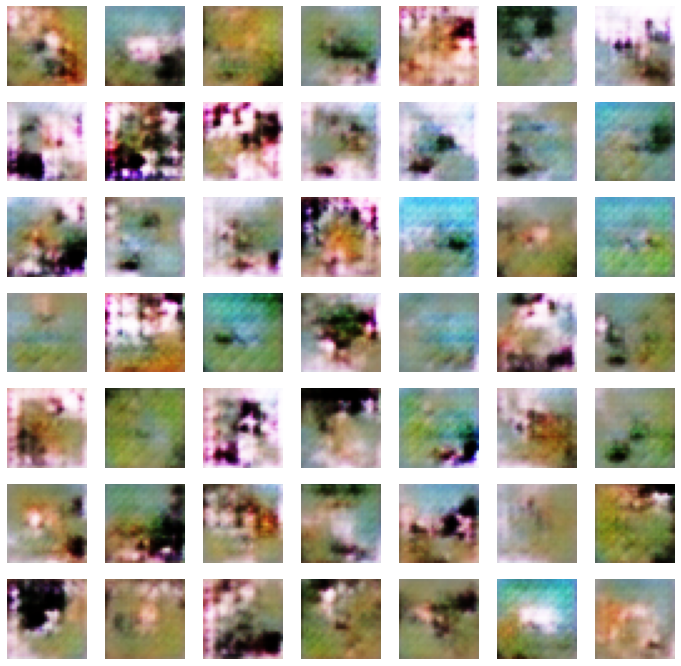

>71, 1/39, d1=0.666, d2=0.499 g=1.350
>71, 2/39, d1=0.570, d2=0.610 g=1.151
>71, 3/39, d1=0.656, d2=0.599 g=1.117
>71, 4/39, d1=0.633, d2=0.547 g=1.071
>71, 5/39, d1=0.587, d2=0.599 g=1.043
>71, 6/39, d1=0.637, d2=0.570 g=1.101
>71, 7/39, d1=0.686, d2=0.578 g=1.068
>71, 8/39, d1=0.627, d2=0.590 g=1.049
>71, 9/39, d1=0.640, d2=0.631 g=1.066
>71, 10/39, d1=0.660, d2=0.517 g=1.101
>71, 11/39, d1=0.649, d2=0.620 g=1.144
>71, 12/39, d1=0.647, d2=0.581 g=1.191
>71, 13/39, d1=0.669, d2=0.531 g=1.219
>71, 14/39, d1=0.679, d2=0.592 g=1.260
>71, 15/39, d1=0.650, d2=0.518 g=1.343
>71, 16/39, d1=0.596, d2=0.446 g=1.276
>71, 17/39, d1=0.662, d2=0.493 g=1.290
>71, 18/39, d1=0.659, d2=0.556 g=1.281
>71, 19/39, d1=0.644, d2=0.454 g=1.224
>71, 20/39, d1=0.683, d2=0.633 g=1.248
>71, 21/39, d1=0.624, d2=0.540 g=1.127
>71, 22/39, d1=0.720, d2=0.539 g=1.184
>71, 23/39, d1=0.696, d2=0.491 g=1.214
>71, 24/39, d1=0.625, d2=0.512 g=1.167
>71, 25/39, d1=0.829, d2=0.546 g=1.203
>71, 26/39, d1=0.643, d2=0.559 g=1

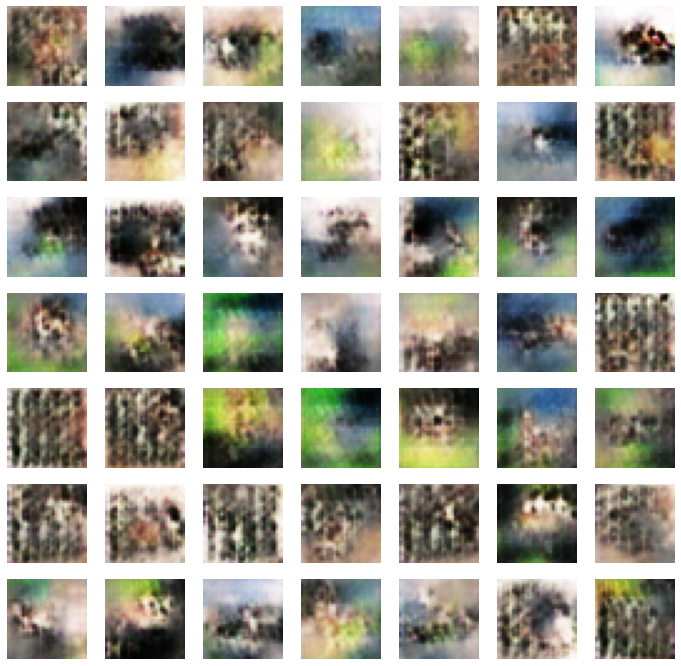

>81, 1/39, d1=0.568, d2=0.561 g=1.047
>81, 2/39, d1=0.656, d2=0.579 g=1.063
>81, 3/39, d1=0.603, d2=0.749 g=1.135
>81, 4/39, d1=0.582, d2=0.538 g=1.077
>81, 5/39, d1=0.692, d2=0.566 g=1.117
>81, 6/39, d1=0.622, d2=0.547 g=1.038
>81, 7/39, d1=0.633, d2=0.619 g=1.031
>81, 8/39, d1=0.713, d2=0.604 g=1.015
>81, 9/39, d1=0.715, d2=0.656 g=1.166
>81, 10/39, d1=0.618, d2=0.513 g=1.097
>81, 11/39, d1=0.588, d2=0.513 g=1.116
>81, 12/39, d1=0.612, d2=0.522 g=1.103
>81, 13/39, d1=0.533, d2=0.588 g=1.081
>81, 14/39, d1=0.565, d2=0.609 g=1.081
>81, 15/39, d1=0.624, d2=0.568 g=1.103
>81, 16/39, d1=0.546, d2=0.551 g=1.105
>81, 17/39, d1=0.615, d2=0.569 g=1.099
>81, 18/39, d1=0.621, d2=0.544 g=1.059
>81, 19/39, d1=0.607, d2=0.587 g=0.994
>81, 20/39, d1=0.566, d2=0.715 g=1.015
>81, 21/39, d1=0.562, d2=0.648 g=1.001
>81, 22/39, d1=0.667, d2=0.584 g=1.013
>81, 23/39, d1=0.707, d2=0.604 g=1.047
>81, 24/39, d1=0.648, d2=0.637 g=1.067
>81, 25/39, d1=0.546, d2=0.595 g=1.048
>81, 26/39, d1=0.508, d2=0.617 g=1

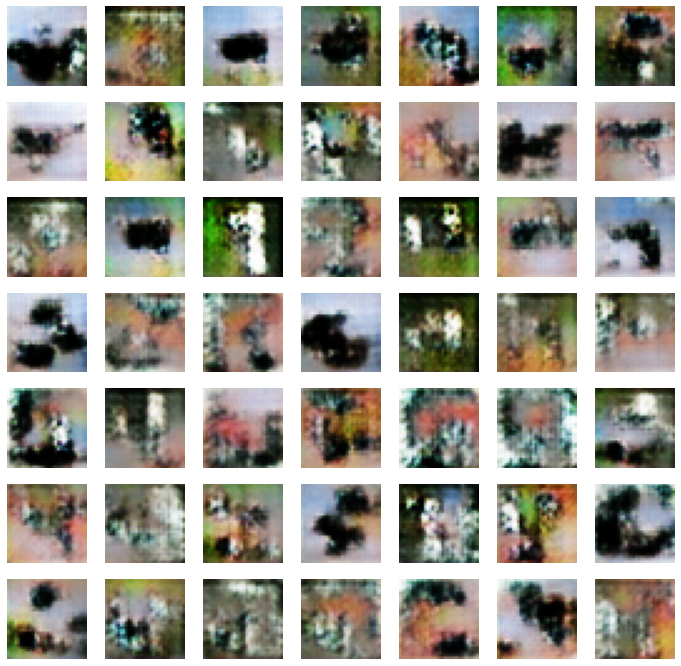

>91, 1/39, d1=0.688, d2=0.458 g=1.451
>91, 2/39, d1=0.659, d2=0.455 g=1.253
>91, 3/39, d1=0.738, d2=0.599 g=1.236
>91, 4/39, d1=0.555, d2=0.594 g=1.255
>91, 5/39, d1=0.618, d2=0.576 g=1.323
>91, 6/39, d1=0.729, d2=0.540 g=1.203
>91, 7/39, d1=0.722, d2=0.567 g=1.216
>91, 8/39, d1=0.673, d2=0.512 g=1.157
>91, 9/39, d1=0.607, d2=0.597 g=1.115
>91, 10/39, d1=0.618, d2=0.622 g=1.202
>91, 11/39, d1=0.770, d2=0.562 g=1.138
>91, 12/39, d1=0.623, d2=0.666 g=1.122
>91, 13/39, d1=0.751, d2=0.572 g=1.229
>91, 14/39, d1=0.731, d2=0.520 g=1.153
>91, 15/39, d1=0.663, d2=0.534 g=1.268
>91, 16/39, d1=0.644, d2=0.567 g=1.121
>91, 17/39, d1=0.599, d2=0.549 g=1.105
>91, 18/39, d1=0.494, d2=0.546 g=1.065
>91, 19/39, d1=0.648, d2=0.646 g=1.008
>91, 20/39, d1=0.608, d2=0.622 g=1.055
>91, 21/39, d1=0.510, d2=0.588 g=1.122
>91, 22/39, d1=0.591, d2=0.578 g=1.145
>91, 23/39, d1=0.616, d2=0.532 g=1.082
>91, 24/39, d1=0.519, d2=0.615 g=1.085
>91, 25/39, d1=0.566, d2=0.589 g=1.109
>91, 26/39, d1=0.509, d2=0.514 g=1

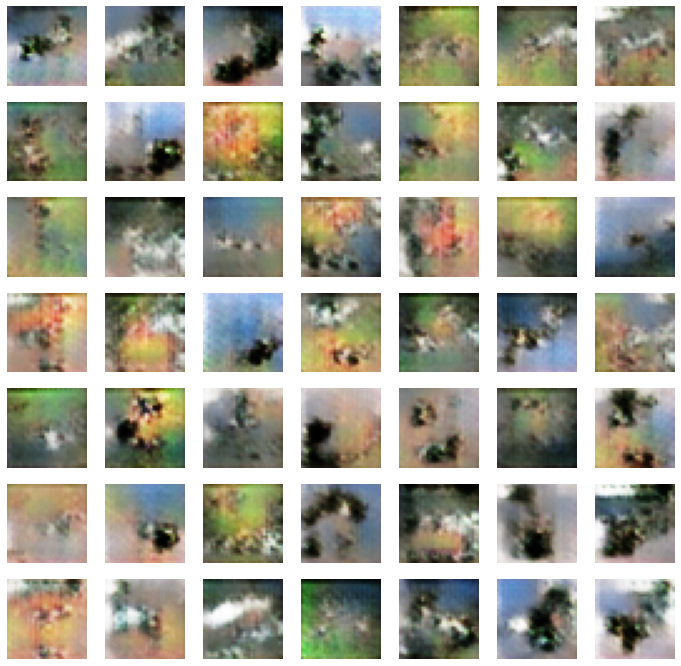

>101, 1/39, d1=0.514, d2=0.543 g=1.252
>101, 2/39, d1=0.775, d2=0.523 g=1.377
>101, 3/39, d1=0.540, d2=0.552 g=1.557
>101, 4/39, d1=0.617, d2=0.360 g=1.610
>101, 5/39, d1=0.547, d2=0.420 g=1.334
>101, 6/39, d1=0.436, d2=0.684 g=1.272
>101, 7/39, d1=0.489, d2=0.560 g=1.273
>101, 8/39, d1=0.592, d2=0.592 g=1.263
>101, 9/39, d1=0.750, d2=0.480 g=1.308
>101, 10/39, d1=0.611, d2=0.533 g=1.335
>101, 11/39, d1=0.558, d2=0.498 g=1.424
>101, 12/39, d1=0.671, d2=0.453 g=1.432
>101, 13/39, d1=0.599, d2=0.525 g=1.305
>101, 14/39, d1=0.576, d2=0.518 g=1.342
>101, 15/39, d1=0.671, d2=0.568 g=1.247
>101, 16/39, d1=0.566, d2=0.599 g=1.263
>101, 17/39, d1=0.601, d2=0.529 g=1.330
>101, 18/39, d1=0.677, d2=0.581 g=1.372
>101, 19/39, d1=0.624, d2=0.480 g=1.550
>101, 20/39, d1=0.684, d2=0.437 g=1.603
>101, 21/39, d1=0.626, d2=0.335 g=1.608
>101, 22/39, d1=0.582, d2=0.355 g=1.534
>101, 23/39, d1=0.522, d2=0.456 g=1.324
>101, 24/39, d1=0.463, d2=0.562 g=1.410
>101, 25/39, d1=0.487, d2=0.540 g=1.415
>101, 26/

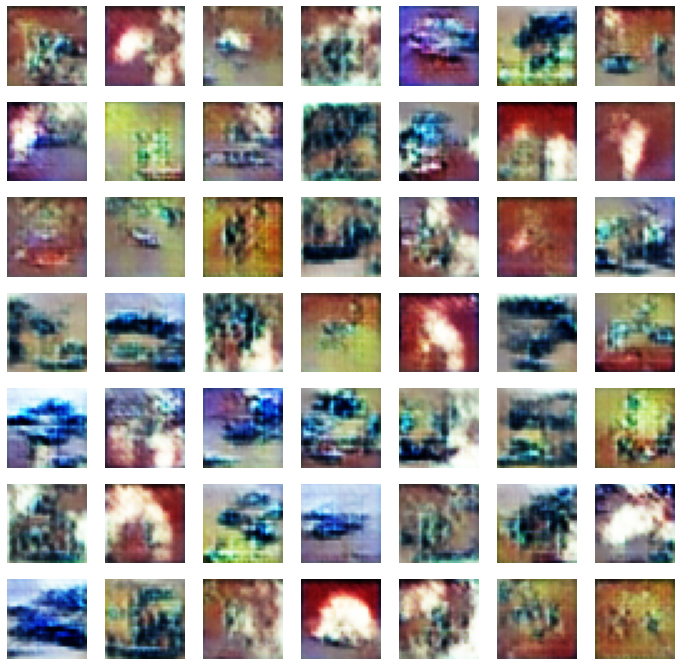

>111, 1/39, d1=0.657, d2=0.596 g=1.267
>111, 2/39, d1=0.535, d2=0.451 g=1.244
>111, 3/39, d1=0.565, d2=0.482 g=1.333
>111, 4/39, d1=0.623, d2=0.505 g=1.367
>111, 5/39, d1=0.576, d2=0.424 g=1.259
>111, 6/39, d1=0.544, d2=0.508 g=1.245
>111, 7/39, d1=0.465, d2=0.604 g=1.177
>111, 8/39, d1=0.472, d2=0.603 g=1.056
>111, 9/39, d1=0.517, d2=0.592 g=1.041
>111, 10/39, d1=0.474, d2=0.705 g=1.086
>111, 11/39, d1=0.572, d2=0.653 g=1.098
>111, 12/39, d1=0.683, d2=0.580 g=1.165
>111, 13/39, d1=0.677, d2=0.567 g=1.154
>111, 14/39, d1=0.624, d2=0.534 g=1.136
>111, 15/39, d1=0.525, d2=0.495 g=1.128
>111, 16/39, d1=0.594, d2=0.700 g=1.103
>111, 17/39, d1=0.587, d2=0.556 g=1.095
>111, 18/39, d1=0.673, d2=0.542 g=1.164
>111, 19/39, d1=0.636, d2=0.544 g=1.172
>111, 20/39, d1=0.658, d2=0.619 g=1.233
>111, 21/39, d1=0.617, d2=0.605 g=1.349
>111, 22/39, d1=0.702, d2=0.481 g=1.206
>111, 23/39, d1=0.561, d2=0.567 g=1.114
>111, 24/39, d1=0.696, d2=0.636 g=1.137
>111, 25/39, d1=0.656, d2=0.622 g=1.155
>111, 26/

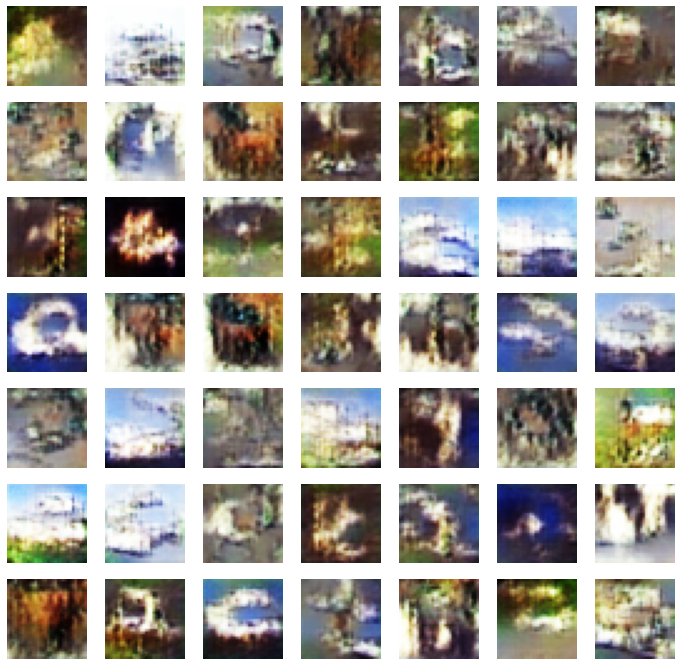

>121, 1/39, d1=0.511, d2=0.625 g=1.065
>121, 2/39, d1=0.551, d2=0.580 g=1.045
>121, 3/39, d1=0.591, d2=0.603 g=1.021
>121, 4/39, d1=0.598, d2=0.636 g=1.025
>121, 5/39, d1=0.589, d2=0.582 g=1.003
>121, 6/39, d1=0.538, d2=0.664 g=1.028
>121, 7/39, d1=0.583, d2=0.682 g=1.021
>121, 8/39, d1=0.658, d2=0.571 g=1.033
>121, 9/39, d1=0.715, d2=0.609 g=0.981
>121, 10/39, d1=0.599, d2=0.657 g=1.043
>121, 11/39, d1=0.647, d2=0.632 g=1.081
>121, 12/39, d1=0.718, d2=0.505 g=1.081
>121, 13/39, d1=0.671, d2=0.502 g=1.112
>121, 14/39, d1=0.642, d2=0.595 g=1.043
>121, 15/39, d1=0.572, d2=0.594 g=0.961
>121, 16/39, d1=0.629, d2=0.642 g=1.014
>121, 17/39, d1=0.606, d2=0.624 g=1.008
>121, 18/39, d1=0.652, d2=0.598 g=1.055
>121, 19/39, d1=0.639, d2=0.576 g=1.082
>121, 20/39, d1=0.604, d2=0.567 g=1.084
>121, 21/39, d1=0.654, d2=0.545 g=1.024
>121, 22/39, d1=0.573, d2=0.574 g=1.068
>121, 23/39, d1=0.699, d2=0.569 g=1.013
>121, 24/39, d1=0.631, d2=0.564 g=1.027
>121, 25/39, d1=0.577, d2=0.615 g=0.996
>121, 26/

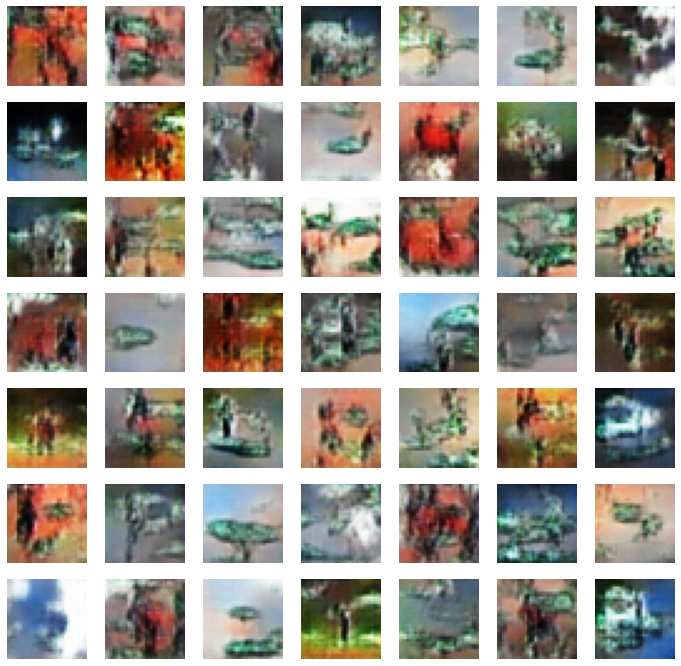

>131, 1/39, d1=0.647, d2=0.647 g=0.926
>131, 2/39, d1=0.551, d2=0.697 g=0.935
>131, 3/39, d1=0.570, d2=0.617 g=0.934
>131, 4/39, d1=0.620, d2=0.603 g=0.985
>131, 5/39, d1=0.664, d2=0.564 g=0.991
>131, 6/39, d1=0.685, d2=0.604 g=1.037
>131, 7/39, d1=0.633, d2=0.619 g=1.118
>131, 8/39, d1=0.688, d2=0.540 g=1.118
>131, 9/39, d1=0.697, d2=0.567 g=1.058
>131, 10/39, d1=0.658, d2=0.530 g=1.036
>131, 11/39, d1=0.672, d2=0.525 g=0.973
>131, 12/39, d1=0.657, d2=0.619 g=0.956
>131, 13/39, d1=0.664, d2=0.610 g=0.976
>131, 14/39, d1=0.609, d2=0.607 g=0.948
>131, 15/39, d1=0.597, d2=0.582 g=0.924
>131, 16/39, d1=0.596, d2=0.597 g=0.988
>131, 17/39, d1=0.581, d2=0.545 g=1.062
>131, 18/39, d1=0.533, d2=0.508 g=1.127
>131, 19/39, d1=0.601, d2=0.546 g=1.119
>131, 20/39, d1=0.529, d2=0.488 g=1.149
>131, 21/39, d1=0.563, d2=0.594 g=1.080
>131, 22/39, d1=0.650, d2=0.610 g=0.954
>131, 23/39, d1=0.573, d2=0.621 g=0.883
>131, 24/39, d1=0.579, d2=0.732 g=0.926
>131, 25/39, d1=0.554, d2=0.589 g=0.961
>131, 26/

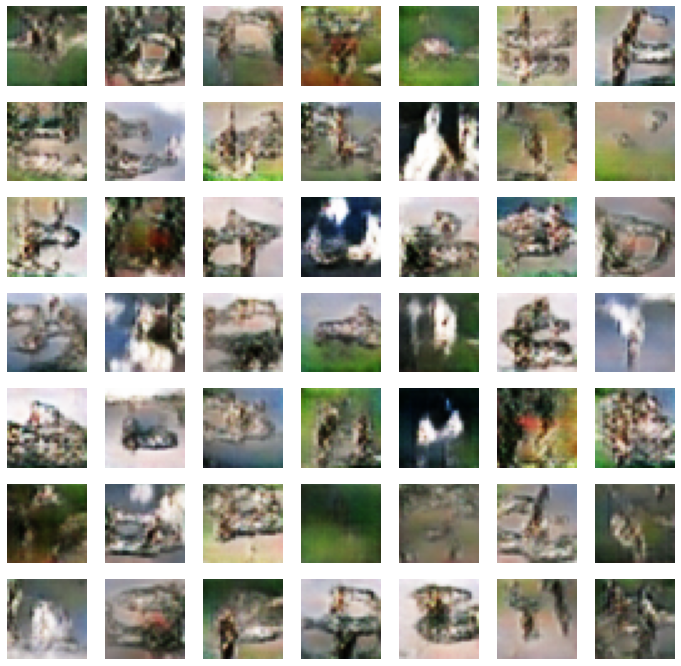

>141, 1/39, d1=0.644, d2=0.638 g=0.980
>141, 2/39, d1=0.653, d2=0.551 g=0.935
>141, 3/39, d1=0.631, d2=0.594 g=0.939
>141, 4/39, d1=0.698, d2=0.580 g=0.873
>141, 5/39, d1=0.574, d2=0.643 g=0.868
>141, 6/39, d1=0.473, d2=0.637 g=0.903
>141, 7/39, d1=0.558, d2=0.717 g=0.910
>141, 8/39, d1=0.612, d2=0.629 g=0.927
>141, 9/39, d1=0.590, d2=0.687 g=1.304
>141, 10/39, d1=0.576, d2=0.361 g=1.476
>141, 11/39, d1=0.582, d2=0.479 g=1.171
>141, 12/39, d1=0.453, d2=0.767 g=0.835
>141, 13/39, d1=0.596, d2=0.745 g=0.950
>141, 14/39, d1=0.648, d2=0.634 g=1.044
>141, 15/39, d1=0.603, d2=0.640 g=1.133
>141, 16/39, d1=0.670, d2=0.509 g=1.104
>141, 17/39, d1=0.703, d2=0.547 g=1.134
>141, 18/39, d1=0.533, d2=0.600 g=1.094
>141, 19/39, d1=0.547, d2=0.725 g=1.013
>141, 20/39, d1=0.588, d2=0.561 g=1.004
>141, 21/39, d1=0.583, d2=0.654 g=1.116
>141, 22/39, d1=0.591, d2=0.597 g=1.123
>141, 23/39, d1=0.761, d2=0.508 g=1.220
>141, 24/39, d1=0.731, d2=0.457 g=1.168
>141, 25/39, d1=0.663, d2=0.646 g=1.083
>141, 26/

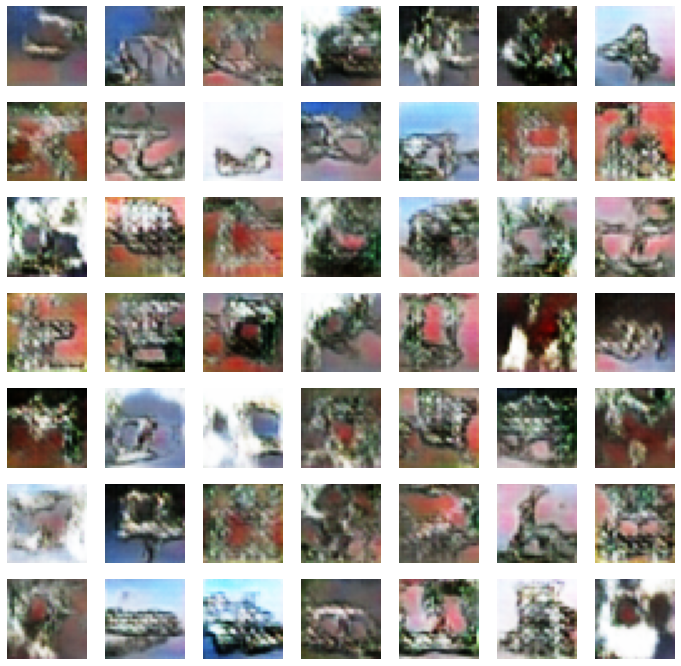

>151, 1/39, d1=0.633, d2=0.597 g=0.993
>151, 2/39, d1=0.599, d2=0.616 g=1.040
>151, 3/39, d1=0.601, d2=0.567 g=0.989
>151, 4/39, d1=0.594, d2=0.649 g=0.932
>151, 5/39, d1=0.600, d2=0.683 g=0.910
>151, 6/39, d1=0.645, d2=0.726 g=0.867
>151, 7/39, d1=0.588, d2=0.765 g=0.912
>151, 8/39, d1=0.674, d2=0.672 g=0.967
>151, 9/39, d1=0.634, d2=0.649 g=1.029
>151, 10/39, d1=0.666, d2=0.561 g=1.022
>151, 11/39, d1=0.642, d2=0.591 g=0.974
>151, 12/39, d1=0.588, d2=0.653 g=0.969
>151, 13/39, d1=0.610, d2=0.681 g=0.957
>151, 14/39, d1=0.571, d2=0.573 g=1.040
>151, 15/39, d1=0.496, d2=0.573 g=1.007
>151, 16/39, d1=0.482, d2=0.667 g=0.884
>151, 17/39, d1=0.500, d2=0.747 g=0.934
>151, 18/39, d1=0.478, d2=0.691 g=0.999
>151, 19/39, d1=0.514, d2=0.643 g=1.131
>151, 20/39, d1=0.709, d2=0.523 g=1.202
>151, 21/39, d1=0.668, d2=0.562 g=1.097
>151, 22/39, d1=0.768, d2=0.576 g=1.062
>151, 23/39, d1=0.741, d2=0.623 g=1.067
>151, 24/39, d1=0.714, d2=0.592 g=0.985
>151, 25/39, d1=0.640, d2=0.708 g=0.905
>151, 26/

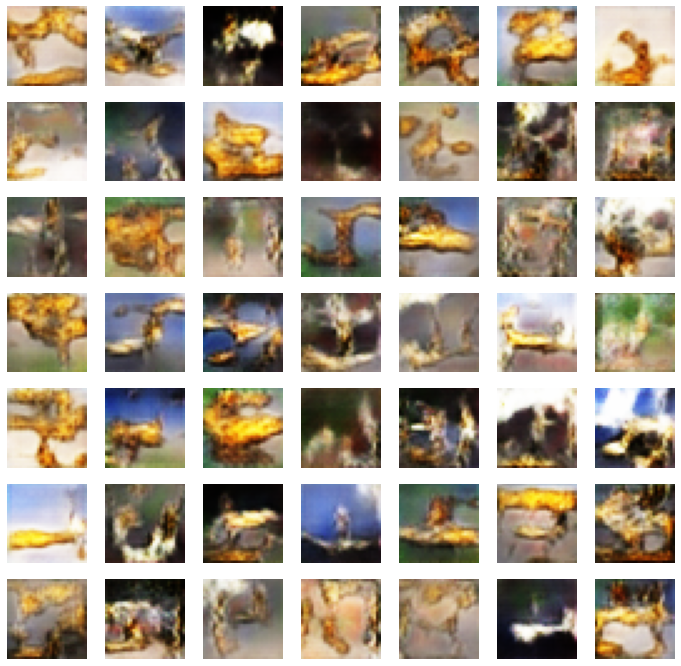

>161, 1/39, d1=0.673, d2=0.573 g=1.036
>161, 2/39, d1=0.715, d2=0.616 g=1.090
>161, 3/39, d1=0.636, d2=0.618 g=1.046
>161, 4/39, d1=0.583, d2=0.566 g=1.012
>161, 5/39, d1=0.568, d2=0.686 g=0.957
>161, 6/39, d1=0.482, d2=0.597 g=0.970
>161, 7/39, d1=0.579, d2=0.684 g=0.992
>161, 8/39, d1=0.587, d2=0.701 g=1.012
>161, 9/39, d1=0.655, d2=0.602 g=0.966
>161, 10/39, d1=0.738, d2=0.647 g=1.013
>161, 11/39, d1=0.723, d2=0.566 g=0.988
>161, 12/39, d1=0.737, d2=0.693 g=0.982
>161, 13/39, d1=0.765, d2=0.568 g=0.989
>161, 14/39, d1=0.715, d2=0.625 g=1.002
>161, 15/39, d1=0.631, d2=0.511 g=1.031
>161, 16/39, d1=0.671, d2=0.626 g=1.036
>161, 17/39, d1=0.638, d2=0.536 g=1.061
>161, 18/39, d1=0.758, d2=0.526 g=1.026
>161, 19/39, d1=0.692, d2=0.578 g=0.967
>161, 20/39, d1=0.621, d2=0.634 g=0.997
>161, 21/39, d1=0.629, d2=0.581 g=1.006
>161, 22/39, d1=0.659, d2=0.619 g=0.983
>161, 23/39, d1=0.744, d2=0.590 g=0.931
>161, 24/39, d1=0.710, d2=0.598 g=0.950
>161, 25/39, d1=0.654, d2=0.567 g=0.981
>161, 26/

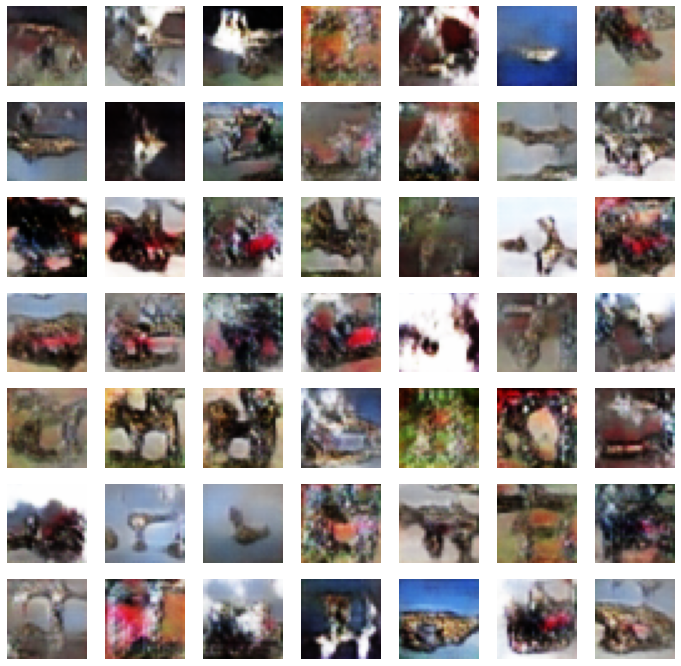

>171, 1/39, d1=0.686, d2=0.573 g=0.877
>171, 2/39, d1=0.564, d2=0.750 g=0.875
>171, 3/39, d1=0.602, d2=0.695 g=0.915
>171, 4/39, d1=0.632, d2=0.641 g=0.956
>171, 5/39, d1=0.637, d2=0.592 g=0.979
>171, 6/39, d1=0.514, d2=0.586 g=0.973
>171, 7/39, d1=0.682, d2=0.531 g=0.922
>171, 8/39, d1=0.653, d2=0.596 g=0.917
>171, 9/39, d1=0.605, d2=0.668 g=0.915
>171, 10/39, d1=0.585, d2=0.706 g=0.899
>171, 11/39, d1=0.603, d2=0.744 g=0.921
>171, 12/39, d1=0.727, d2=0.597 g=0.952
>171, 13/39, d1=0.723, d2=0.614 g=0.974
>171, 14/39, d1=0.682, d2=0.544 g=0.999
>171, 15/39, d1=0.664, d2=0.595 g=0.979
>171, 16/39, d1=0.650, d2=0.613 g=0.967
>171, 17/39, d1=0.649, d2=0.612 g=1.021
>171, 18/39, d1=0.531, d2=0.599 g=0.978
>171, 19/39, d1=0.619, d2=0.669 g=0.953
>171, 20/39, d1=0.655, d2=0.656 g=0.895
>171, 21/39, d1=0.563, d2=0.689 g=0.930
>171, 22/39, d1=0.634, d2=0.625 g=0.900
>171, 23/39, d1=0.692, d2=0.681 g=0.903
>171, 24/39, d1=0.647, d2=0.641 g=0.879
>171, 25/39, d1=0.752, d2=0.699 g=0.863
>171, 26/

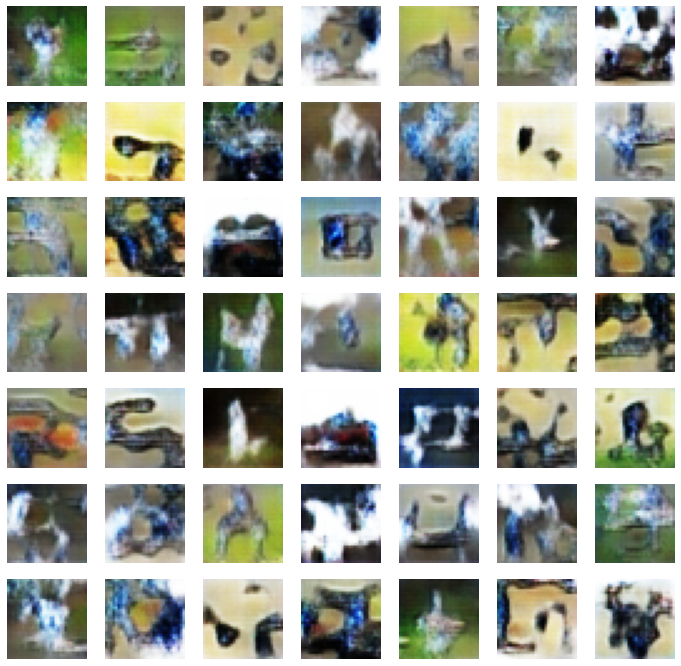

>181, 1/39, d1=0.505, d2=0.768 g=1.078
>181, 2/39, d1=0.524, d2=0.543 g=1.113
>181, 3/39, d1=0.621, d2=0.653 g=1.060
>181, 4/39, d1=0.541, d2=0.597 g=1.002
>181, 5/39, d1=0.680, d2=0.605 g=1.022
>181, 6/39, d1=0.629, d2=0.542 g=1.028
>181, 7/39, d1=0.640, d2=0.663 g=1.063
>181, 8/39, d1=0.618, d2=0.631 g=1.022
>181, 9/39, d1=0.733, d2=0.681 g=1.016
>181, 10/39, d1=0.700, d2=0.616 g=0.998
>181, 11/39, d1=0.728, d2=0.558 g=1.048
>181, 12/39, d1=0.713, d2=0.522 g=1.075
>181, 13/39, d1=0.681, d2=0.536 g=1.051
>181, 14/39, d1=0.685, d2=0.520 g=1.019
>181, 15/39, d1=0.710, d2=0.567 g=1.007
>181, 16/39, d1=0.698, d2=0.564 g=0.945
>181, 17/39, d1=0.633, d2=0.610 g=0.943
>181, 18/39, d1=0.690, d2=0.650 g=0.941
>181, 19/39, d1=0.652, d2=0.713 g=0.896
>181, 20/39, d1=0.670, d2=0.624 g=0.930
>181, 21/39, d1=0.691, d2=0.704 g=0.936
>181, 22/39, d1=0.702, d2=0.571 g=0.952
>181, 23/39, d1=0.638, d2=0.581 g=0.978
>181, 24/39, d1=0.678, d2=0.615 g=1.002
>181, 25/39, d1=0.635, d2=0.567 g=0.963
>181, 26/

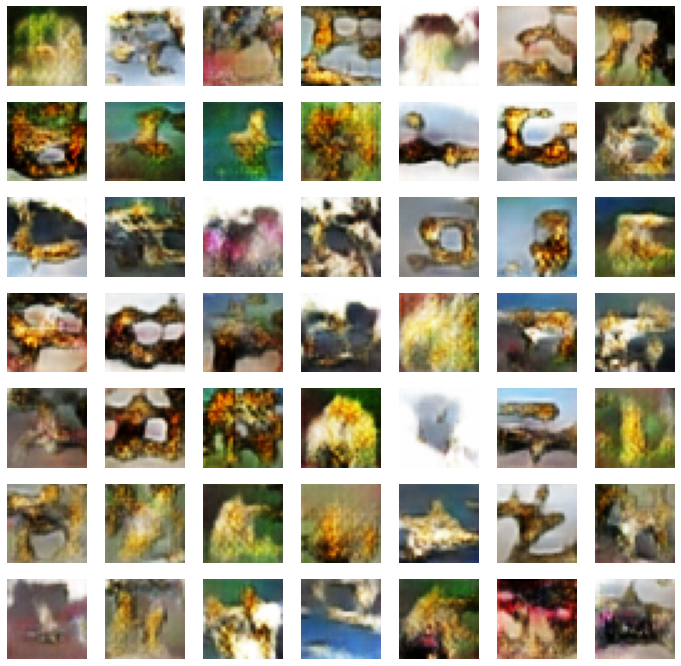

>191, 1/39, d1=0.581, d2=0.688 g=0.929
>191, 2/39, d1=0.690, d2=0.587 g=0.910
>191, 3/39, d1=0.679, d2=0.618 g=0.924
>191, 4/39, d1=0.702, d2=0.578 g=0.913
>191, 5/39, d1=0.612, d2=0.622 g=0.925
>191, 6/39, d1=0.658, d2=0.575 g=0.904
>191, 7/39, d1=0.635, d2=0.627 g=0.904
>191, 8/39, d1=0.664, d2=0.631 g=0.882
>191, 9/39, d1=0.723, d2=0.633 g=0.928
>191, 10/39, d1=0.666, d2=0.627 g=0.900
>191, 11/39, d1=0.598, d2=0.629 g=0.853
>191, 12/39, d1=0.686, d2=0.645 g=0.917
>191, 13/39, d1=0.660, d2=0.614 g=0.869
>191, 14/39, d1=0.651, d2=0.653 g=0.862
>191, 15/39, d1=0.559, d2=0.692 g=0.888
>191, 16/39, d1=0.635, d2=0.606 g=0.966
>191, 17/39, d1=0.652, d2=0.626 g=0.939
>191, 18/39, d1=0.675, d2=0.594 g=0.979
>191, 19/39, d1=0.597, d2=0.588 g=0.956
>191, 20/39, d1=0.618, d2=0.582 g=0.964
>191, 21/39, d1=0.630, d2=0.610 g=0.958
>191, 22/39, d1=0.609, d2=0.592 g=0.956
>191, 23/39, d1=0.670, d2=0.562 g=0.929
>191, 24/39, d1=0.676, d2=0.651 g=0.912
>191, 25/39, d1=0.673, d2=0.601 g=0.942
>191, 26/

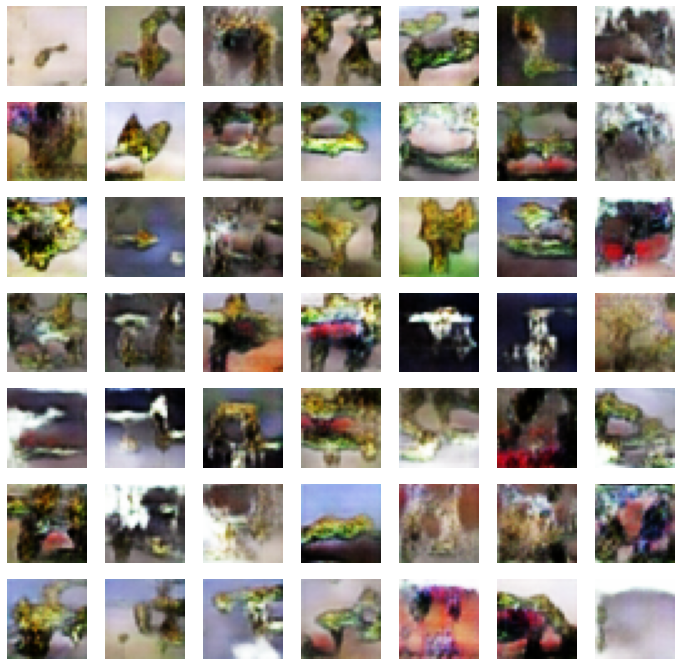

>201, 1/39, d1=0.610, d2=0.618 g=0.906
>201, 2/39, d1=0.506, d2=0.670 g=0.905
>201, 3/39, d1=0.557, d2=0.699 g=0.961
>201, 4/39, d1=0.577, d2=0.674 g=0.993
>201, 5/39, d1=0.690, d2=0.660 g=0.914
>201, 6/39, d1=0.714, d2=0.710 g=0.958
>201, 7/39, d1=0.603, d2=0.663 g=0.920
>201, 8/39, d1=0.656, d2=0.695 g=1.038
>201, 9/39, d1=0.704, d2=0.584 g=1.095
>201, 10/39, d1=0.688, d2=0.515 g=1.093
>201, 11/39, d1=0.706, d2=0.608 g=0.991
>201, 12/39, d1=0.645, d2=0.688 g=0.987
>201, 13/39, d1=0.569, d2=0.621 g=1.005
>201, 14/39, d1=0.709, d2=0.595 g=0.944
>201, 15/39, d1=0.744, d2=0.567 g=0.953
>201, 16/39, d1=0.601, d2=0.590 g=0.997
>201, 17/39, d1=0.568, d2=0.641 g=0.937
>201, 18/39, d1=0.592, d2=0.573 g=1.009
>201, 19/39, d1=0.673, d2=0.589 g=1.002
>201, 20/39, d1=0.646, d2=0.541 g=1.027
>201, 21/39, d1=0.681, d2=0.580 g=0.992
>201, 22/39, d1=0.736, d2=0.614 g=0.925
>201, 23/39, d1=0.632, d2=0.588 g=0.989
>201, 24/39, d1=0.672, d2=0.608 g=0.930
>201, 25/39, d1=0.609, d2=0.585 g=0.984
>201, 26/

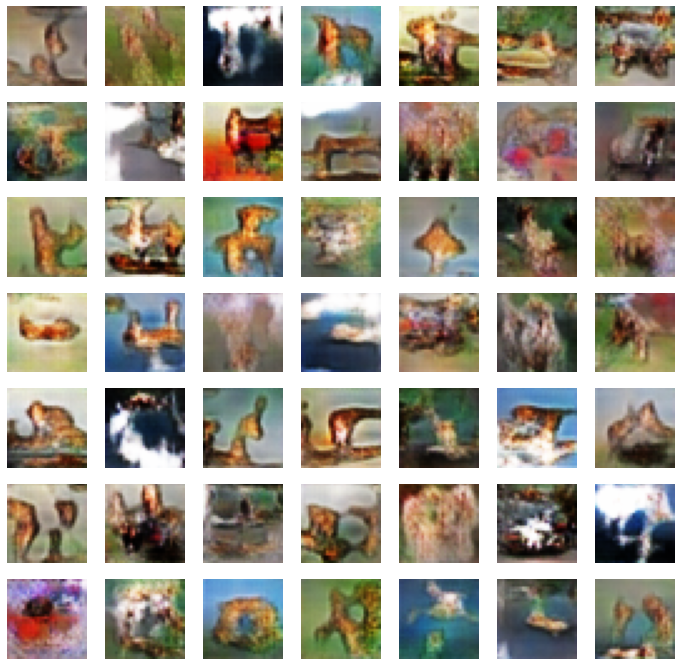

>211, 1/39, d1=0.630, d2=0.569 g=0.983
>211, 2/39, d1=0.612, d2=0.609 g=0.999
>211, 3/39, d1=0.550, d2=0.602 g=1.018
>211, 4/39, d1=0.647, d2=0.580 g=1.029
>211, 5/39, d1=0.595, d2=0.518 g=0.995
>211, 6/39, d1=0.617, d2=0.636 g=0.926
>211, 7/39, d1=0.583, d2=0.673 g=0.884
>211, 8/39, d1=0.580, d2=0.609 g=0.916
>211, 9/39, d1=0.546, d2=0.702 g=0.936
>211, 10/39, d1=0.609, d2=0.651 g=1.014
>211, 11/39, d1=0.570, d2=0.568 g=1.068
>211, 12/39, d1=0.711, d2=0.625 g=0.967
>211, 13/39, d1=0.682, d2=0.641 g=0.890
>211, 14/39, d1=0.645, d2=0.585 g=0.918
>211, 15/39, d1=0.571, d2=0.616 g=0.903
>211, 16/39, d1=0.621, d2=0.614 g=0.964
>211, 17/39, d1=0.594, d2=0.588 g=0.925
>211, 18/39, d1=0.591, d2=0.710 g=0.980
>211, 19/39, d1=0.635, d2=0.645 g=1.066
>211, 20/39, d1=0.617, d2=0.592 g=0.996
>211, 21/39, d1=0.592, d2=0.616 g=0.957
>211, 22/39, d1=0.650, d2=0.731 g=1.063
>211, 23/39, d1=0.672, d2=0.589 g=1.032
>211, 24/39, d1=0.723, d2=0.516 g=0.943
>211, 25/39, d1=0.652, d2=0.667 g=0.948
>211, 26/

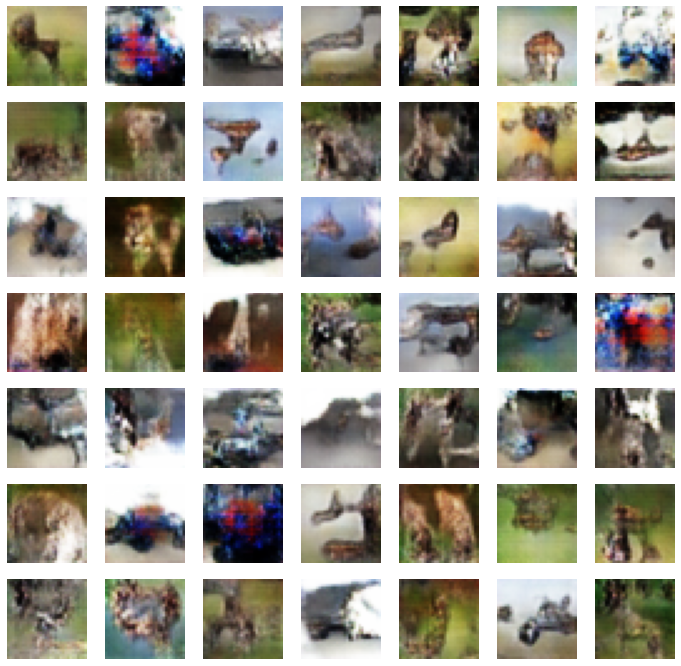

>221, 1/39, d1=0.558, d2=0.633 g=1.035
>221, 2/39, d1=0.536, d2=0.684 g=0.982
>221, 3/39, d1=0.618, d2=0.607 g=1.079
>221, 4/39, d1=0.595, d2=0.514 g=1.096
>221, 5/39, d1=0.596, d2=0.550 g=1.068
>221, 6/39, d1=0.508, d2=0.617 g=1.096
>221, 7/39, d1=0.555, d2=0.792 g=1.110
>221, 8/39, d1=0.657, d2=0.515 g=0.999
>221, 9/39, d1=0.583, d2=0.743 g=0.994
>221, 10/39, d1=0.766, d2=0.604 g=1.059
>221, 11/39, d1=0.682, d2=0.613 g=1.061
>221, 12/39, d1=0.721, d2=0.565 g=1.096
>221, 13/39, d1=0.679, d2=0.474 g=1.061
>221, 14/39, d1=0.645, d2=0.573 g=1.066
>221, 15/39, d1=0.710, d2=0.610 g=1.056
>221, 16/39, d1=0.598, d2=0.636 g=1.043
>221, 17/39, d1=0.623, d2=0.556 g=0.998
>221, 18/39, d1=0.570, d2=0.621 g=0.991
>221, 19/39, d1=0.709, d2=0.561 g=0.983
>221, 20/39, d1=0.629, d2=0.627 g=0.971
>221, 21/39, d1=0.589, d2=0.633 g=1.017
>221, 22/39, d1=0.618, d2=0.586 g=0.956
>221, 23/39, d1=0.636, d2=0.600 g=0.964
>221, 24/39, d1=0.563, d2=0.588 g=0.997
>221, 25/39, d1=0.573, d2=0.788 g=0.947
>221, 26/

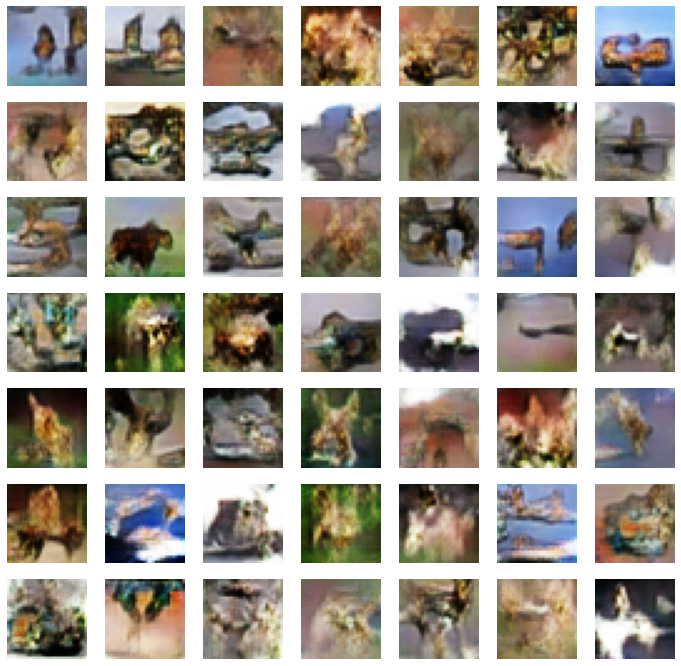

>231, 1/39, d1=0.592, d2=0.546 g=1.032
>231, 2/39, d1=0.633, d2=0.647 g=0.983
>231, 3/39, d1=0.550, d2=0.616 g=0.975
>231, 4/39, d1=0.603, d2=0.593 g=1.030
>231, 5/39, d1=0.620, d2=0.598 g=1.004
>231, 6/39, d1=0.585, d2=0.575 g=0.989
>231, 7/39, d1=0.610, d2=0.609 g=0.959
>231, 8/39, d1=0.592, d2=0.609 g=0.973
>231, 9/39, d1=0.554, d2=0.587 g=0.969
>231, 10/39, d1=0.621, d2=0.544 g=1.021
>231, 11/39, d1=0.653, d2=0.589 g=0.921
>231, 12/39, d1=0.670, d2=0.676 g=0.919
>231, 13/39, d1=0.516, d2=0.617 g=0.938
>231, 14/39, d1=0.571, d2=0.612 g=0.946
>231, 15/39, d1=0.563, d2=0.669 g=1.024
>231, 16/39, d1=0.614, d2=0.577 g=1.006
>231, 17/39, d1=0.676, d2=0.538 g=1.000
>231, 18/39, d1=0.654, d2=0.571 g=0.972
>231, 19/39, d1=0.509, d2=0.654 g=0.949
>231, 20/39, d1=0.565, d2=0.585 g=0.966
>231, 21/39, d1=0.643, d2=0.545 g=1.016
>231, 22/39, d1=0.606, d2=0.623 g=0.975
>231, 23/39, d1=0.588, d2=0.730 g=1.058
>231, 24/39, d1=0.616, d2=0.579 g=1.008
>231, 25/39, d1=0.581, d2=0.591 g=1.000
>231, 26/

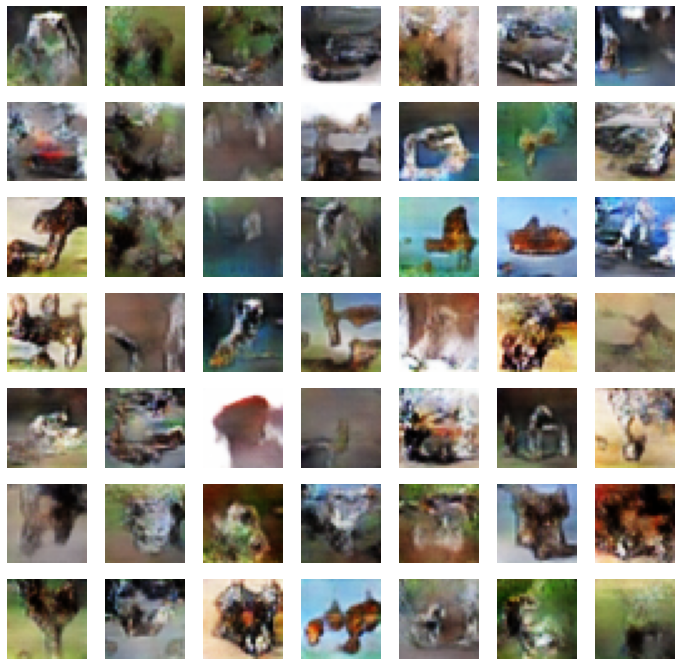

>241, 1/39, d1=0.649, d2=0.533 g=0.917
>241, 2/39, d1=0.590, d2=0.671 g=1.012
>241, 3/39, d1=0.544, d2=0.672 g=0.923
>241, 4/39, d1=0.577, d2=0.635 g=0.948
>241, 5/39, d1=0.617, d2=0.584 g=0.944
>241, 6/39, d1=0.601, d2=0.603 g=0.974
>241, 7/39, d1=0.584, d2=0.610 g=1.030
>241, 8/39, d1=0.586, d2=0.576 g=1.032
>241, 9/39, d1=0.640, d2=0.581 g=1.047
>241, 10/39, d1=0.584, d2=0.564 g=0.990
>241, 11/39, d1=0.640, d2=0.582 g=0.950
>241, 12/39, d1=0.556, d2=0.611 g=0.960
>241, 13/39, d1=0.592, d2=0.576 g=0.960
>241, 14/39, d1=0.633, d2=0.625 g=0.966
>241, 15/39, d1=0.613, d2=0.635 g=0.966
>241, 16/39, d1=0.648, d2=0.595 g=1.027
>241, 17/39, d1=0.602, d2=0.554 g=0.992
>241, 18/39, d1=0.635, d2=0.527 g=1.007
>241, 19/39, d1=0.619, d2=0.584 g=0.908
>241, 20/39, d1=0.592, d2=0.641 g=1.001
>241, 21/39, d1=0.634, d2=0.542 g=1.029
>241, 22/39, d1=0.599, d2=0.545 g=1.018
>241, 23/39, d1=0.584, d2=0.590 g=1.019
>241, 24/39, d1=0.593, d2=0.621 g=0.964
>241, 25/39, d1=0.544, d2=0.574 g=0.954
>241, 26/

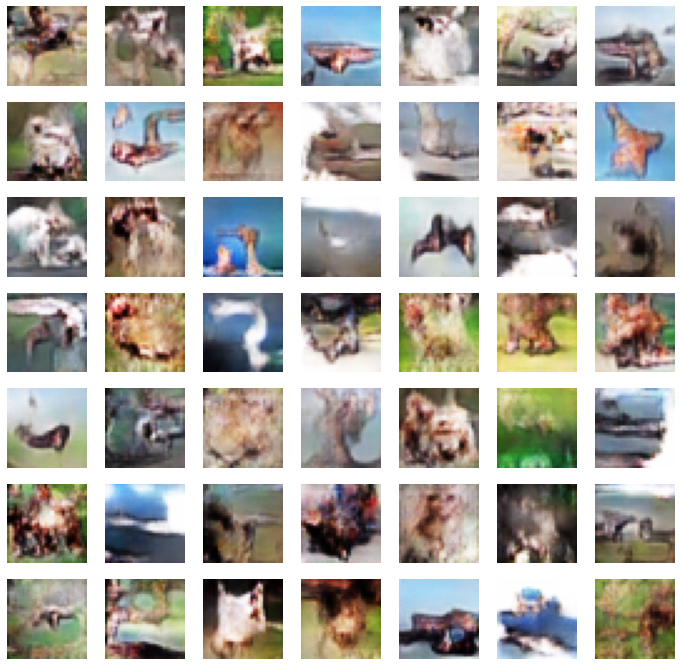

>251, 1/39, d1=0.625, d2=0.575 g=1.100
>251, 2/39, d1=0.616, d2=0.552 g=1.108
>251, 3/39, d1=0.661, d2=0.680 g=0.912
>251, 4/39, d1=0.657, d2=0.584 g=0.913
>251, 5/39, d1=0.618, d2=0.610 g=0.964
>251, 6/39, d1=0.552, d2=0.592 g=0.938
>251, 7/39, d1=0.565, d2=0.679 g=0.922
>251, 8/39, d1=0.615, d2=0.654 g=1.043
>251, 9/39, d1=0.647, d2=0.544 g=1.005
>251, 10/39, d1=0.576, d2=0.603 g=1.068
>251, 11/39, d1=0.633, d2=0.597 g=0.977
>251, 12/39, d1=0.609, d2=0.575 g=1.046
>251, 13/39, d1=0.563, d2=0.607 g=1.113
>251, 14/39, d1=0.687, d2=0.602 g=1.058
>251, 15/39, d1=0.640, d2=0.586 g=1.022
>251, 16/39, d1=0.547, d2=0.563 g=1.003
>251, 17/39, d1=0.528, d2=0.618 g=0.913
>251, 18/39, d1=0.619, d2=0.608 g=0.960
>251, 19/39, d1=0.611, d2=0.584 g=0.960
>251, 20/39, d1=0.517, d2=0.554 g=1.035
>251, 21/39, d1=0.573, d2=0.614 g=1.061
>251, 22/39, d1=0.569, d2=0.513 g=1.011
>251, 23/39, d1=0.651, d2=0.545 g=1.001
>251, 24/39, d1=0.602, d2=0.671 g=0.965
>251, 25/39, d1=0.595, d2=0.574 g=0.987
>251, 26/

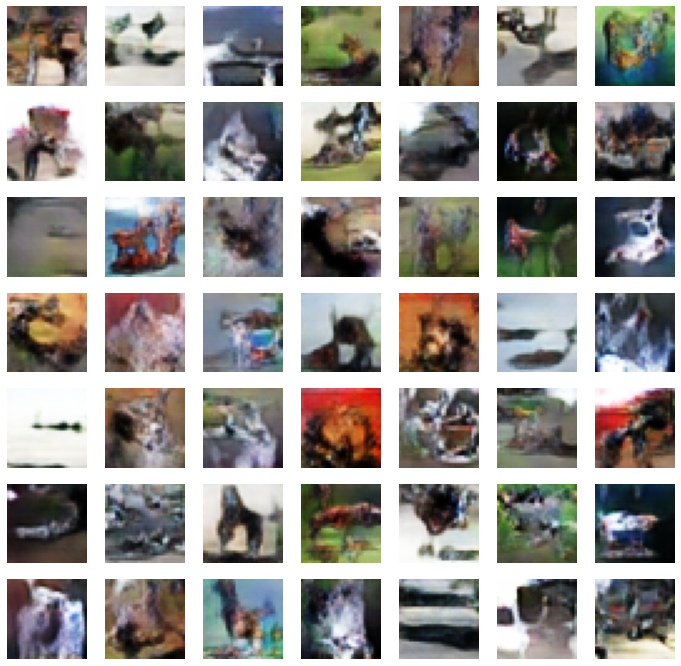

>261, 1/39, d1=0.520, d2=0.704 g=1.040
>261, 2/39, d1=0.686, d2=0.522 g=1.082
>261, 3/39, d1=0.703, d2=0.565 g=1.087
>261, 4/39, d1=0.626, d2=0.559 g=1.082
>261, 5/39, d1=0.607, d2=0.477 g=1.028
>261, 6/39, d1=0.532, d2=0.569 g=0.971
>261, 7/39, d1=0.506, d2=0.556 g=0.982
>261, 8/39, d1=0.581, d2=0.676 g=0.986
>261, 9/39, d1=0.630, d2=0.651 g=0.983
>261, 10/39, d1=0.614, d2=0.584 g=1.050
>261, 11/39, d1=0.551, d2=0.582 g=1.111
>261, 12/39, d1=0.650, d2=0.565 g=1.086
>261, 13/39, d1=0.618, d2=0.588 g=1.097
>261, 14/39, d1=0.557, d2=0.558 g=1.144
>261, 15/39, d1=0.628, d2=0.450 g=1.136
>261, 16/39, d1=0.659, d2=0.566 g=1.050
>261, 17/39, d1=0.694, d2=0.668 g=0.932
>261, 18/39, d1=0.564, d2=0.675 g=1.012
>261, 19/39, d1=0.565, d2=0.568 g=1.052
>261, 20/39, d1=0.658, d2=0.522 g=1.045
>261, 21/39, d1=0.707, d2=0.559 g=0.980
>261, 22/39, d1=0.622, d2=0.676 g=0.887
>261, 23/39, d1=0.512, d2=0.679 g=0.923
>261, 24/39, d1=0.553, d2=0.691 g=0.985
>261, 25/39, d1=0.588, d2=0.536 g=1.022
>261, 26/

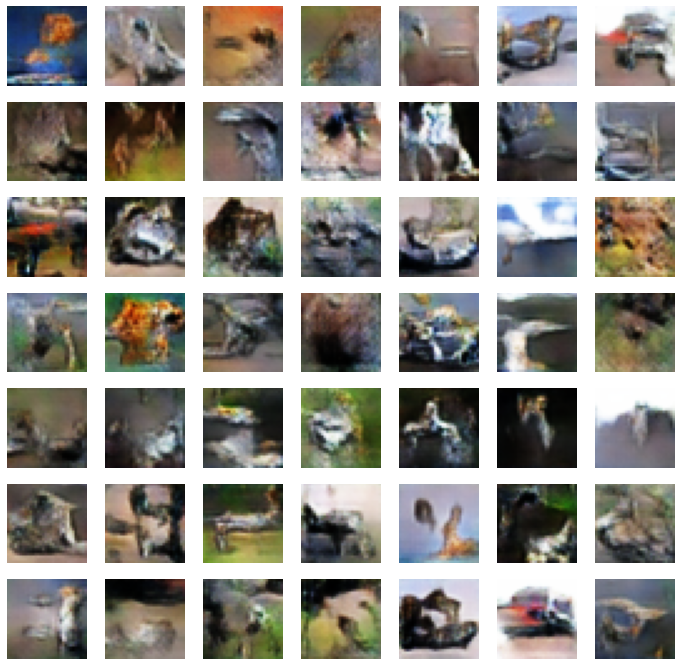

>271, 1/39, d1=0.578, d2=0.493 g=1.126
>271, 2/39, d1=0.588, d2=0.511 g=1.081
>271, 3/39, d1=0.561, d2=0.535 g=1.051
>271, 4/39, d1=0.494, d2=0.557 g=1.064
>271, 5/39, d1=0.634, d2=0.565 g=1.110
>271, 6/39, d1=0.649, d2=0.714 g=1.175
>271, 7/39, d1=0.644, d2=0.486 g=1.183
>271, 8/39, d1=0.762, d2=0.462 g=1.153
>271, 9/39, d1=0.614, d2=0.614 g=1.032
>271, 10/39, d1=0.536, d2=0.630 g=1.007
>271, 11/39, d1=0.591, d2=0.583 g=1.014
>271, 12/39, d1=0.555, d2=0.589 g=0.987
>271, 13/39, d1=0.658, d2=0.579 g=1.157
>271, 14/39, d1=0.640, d2=0.489 g=1.173
>271, 15/39, d1=0.538, d2=0.549 g=1.070
>271, 16/39, d1=0.639, d2=0.725 g=1.057
>271, 17/39, d1=0.589, d2=0.621 g=0.994
>271, 18/39, d1=0.578, d2=0.574 g=1.083
>271, 19/39, d1=0.615, d2=0.663 g=1.080
>271, 20/39, d1=0.621, d2=0.536 g=1.021
>271, 21/39, d1=0.604, d2=0.542 g=1.028
>271, 22/39, d1=0.604, d2=0.528 g=1.149
>271, 23/39, d1=0.645, d2=0.560 g=1.109
>271, 24/39, d1=0.622, d2=0.551 g=1.145
>271, 25/39, d1=0.595, d2=0.535 g=1.160
>271, 26/

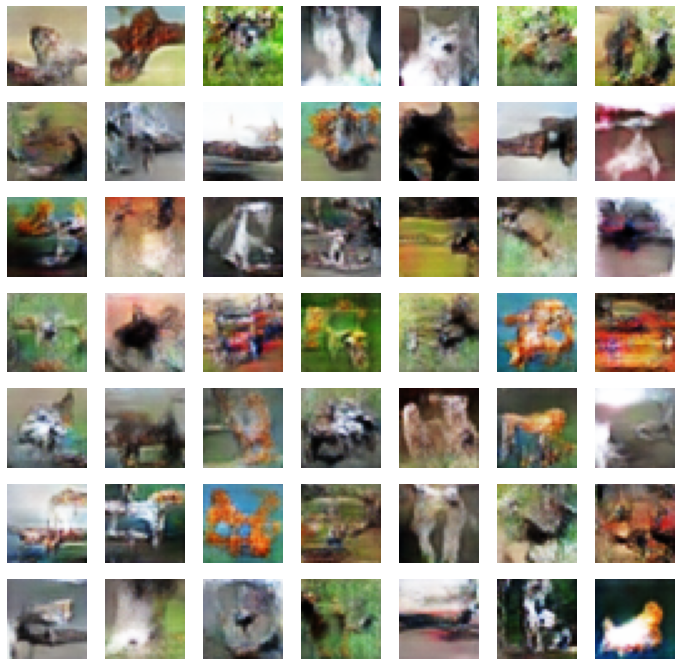

>281, 1/39, d1=0.556, d2=0.647 g=1.013
>281, 2/39, d1=0.558, d2=0.597 g=1.066
>281, 3/39, d1=0.551, d2=0.602 g=1.056
>281, 4/39, d1=0.511, d2=0.561 g=1.000
>281, 5/39, d1=0.559, d2=0.535 g=1.064
>281, 6/39, d1=0.467, d2=0.573 g=1.082
>281, 7/39, d1=0.608, d2=0.533 g=1.019
>281, 8/39, d1=0.571, d2=0.513 g=1.016
>281, 9/39, d1=0.606, d2=0.563 g=1.141
>281, 10/39, d1=0.729, d2=0.593 g=1.062
>281, 11/39, d1=0.605, d2=0.631 g=1.060
>281, 12/39, d1=0.591, d2=0.630 g=1.063
>281, 13/39, d1=0.562, d2=0.530 g=1.074
>281, 14/39, d1=0.622, d2=0.553 g=1.066
>281, 15/39, d1=0.523, d2=0.573 g=1.101
>281, 16/39, d1=0.533, d2=0.590 g=1.075
>281, 17/39, d1=0.594, d2=0.610 g=1.029
>281, 18/39, d1=0.620, d2=0.546 g=1.091
>281, 19/39, d1=0.632, d2=0.570 g=1.120
>281, 20/39, d1=0.613, d2=0.540 g=1.135
>281, 21/39, d1=0.645, d2=0.610 g=1.059
>281, 22/39, d1=0.615, d2=0.560 g=1.090
>281, 23/39, d1=0.617, d2=0.641 g=1.099
>281, 24/39, d1=0.644, d2=0.618 g=1.020
>281, 25/39, d1=0.539, d2=0.558 g=1.028
>281, 26/

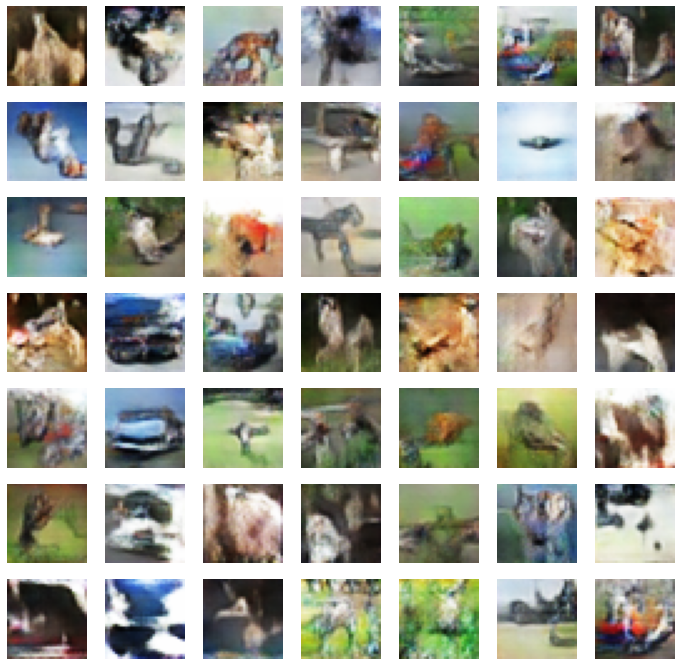

>291, 1/39, d1=0.575, d2=0.572 g=0.988
>291, 2/39, d1=0.638, d2=0.580 g=1.035
>291, 3/39, d1=0.542, d2=0.535 g=1.100
>291, 4/39, d1=0.624, d2=0.542 g=1.025
>291, 5/39, d1=0.594, d2=0.544 g=0.994
>291, 6/39, d1=0.611, d2=0.581 g=1.016
>291, 7/39, d1=0.667, d2=0.605 g=1.013
>291, 8/39, d1=0.677, d2=0.558 g=0.950
>291, 9/39, d1=0.527, d2=0.627 g=0.961
>291, 10/39, d1=0.596, d2=0.628 g=1.110
>291, 11/39, d1=0.574, d2=0.546 g=1.113
>291, 12/39, d1=0.653, d2=0.559 g=1.080
>291, 13/39, d1=0.555, d2=0.588 g=1.061
>291, 14/39, d1=0.593, d2=0.520 g=1.169
>291, 15/39, d1=0.585, d2=0.554 g=1.099
>291, 16/39, d1=0.576, d2=0.581 g=1.057
>291, 17/39, d1=0.607, d2=0.570 g=1.149
>291, 18/39, d1=0.703, d2=0.531 g=1.096
>291, 19/39, d1=0.575, d2=0.574 g=0.979
>291, 20/39, d1=0.552, d2=0.561 g=1.028
>291, 21/39, d1=0.566, d2=0.631 g=1.038
>291, 22/39, d1=0.555, d2=0.664 g=1.022
>291, 23/39, d1=0.650, d2=0.625 g=0.975
>291, 24/39, d1=0.555, d2=0.656 g=1.034
>291, 25/39, d1=0.551, d2=0.620 g=1.065
>291, 26/

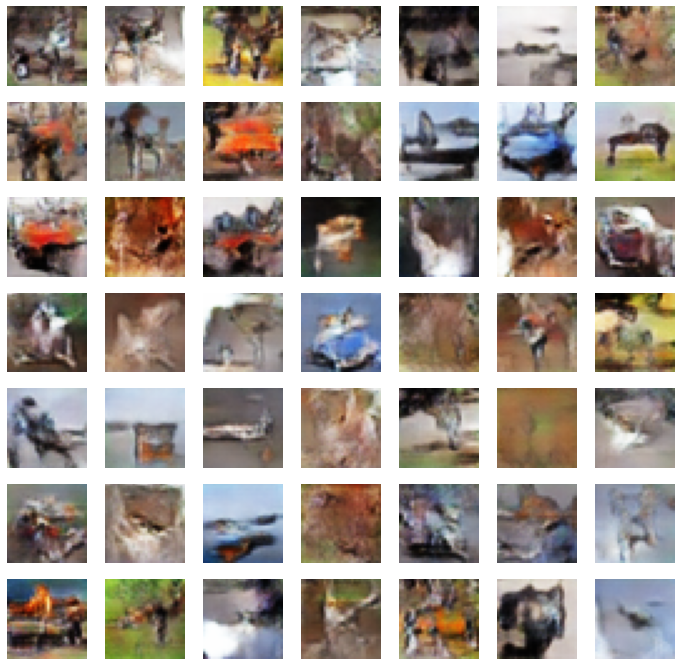

>301, 1/39, d1=0.551, d2=0.547 g=1.050
>301, 2/39, d1=0.610, d2=0.563 g=1.145
>301, 3/39, d1=0.557, d2=0.567 g=1.113
>301, 4/39, d1=0.627, d2=0.587 g=1.118
>301, 5/39, d1=0.601, d2=0.515 g=1.101
>301, 6/39, d1=0.635, d2=0.554 g=1.099
>301, 7/39, d1=0.605, d2=0.609 g=1.011
>301, 8/39, d1=0.634, d2=0.509 g=1.080
>301, 9/39, d1=0.664, d2=0.593 g=1.094
>301, 10/39, d1=0.590, d2=0.557 g=1.086
>301, 11/39, d1=0.578, d2=0.593 g=1.076
>301, 12/39, d1=0.626, d2=0.559 g=1.099
>301, 13/39, d1=0.569, d2=0.630 g=1.075
>301, 14/39, d1=0.550, d2=0.549 g=1.151
>301, 15/39, d1=0.547, d2=0.608 g=1.230
>301, 16/39, d1=0.695, d2=0.575 g=1.119
>301, 17/39, d1=0.671, d2=0.488 g=1.122
>301, 18/39, d1=0.559, d2=0.580 g=1.099
>301, 19/39, d1=0.590, d2=0.539 g=1.103
>301, 20/39, d1=0.654, d2=0.539 g=1.067
>301, 21/39, d1=0.524, d2=0.611 g=1.113
>301, 22/39, d1=0.465, d2=0.545 g=1.164
>301, 23/39, d1=0.681, d2=0.503 g=1.120
>301, 24/39, d1=0.658, d2=0.585 g=1.089
>301, 25/39, d1=0.606, d2=0.554 g=1.023
>301, 26/

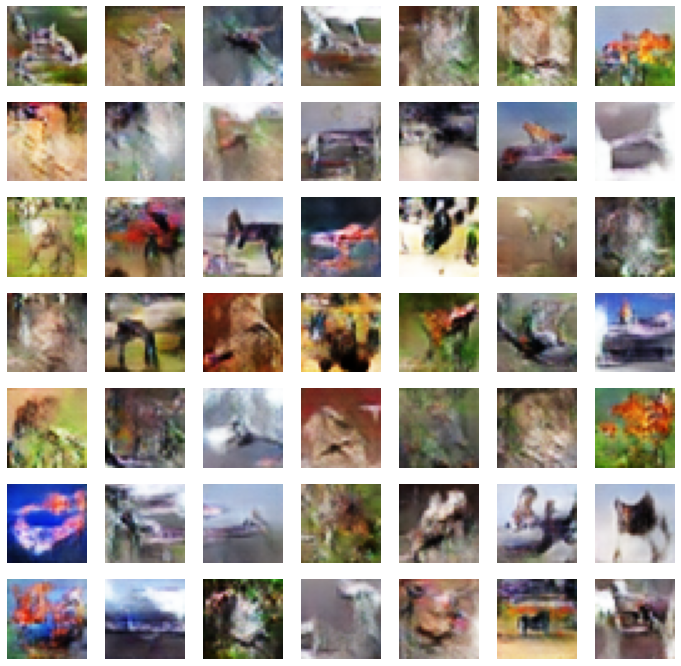

>311, 1/39, d1=0.543, d2=0.523 g=1.042
>311, 2/39, d1=0.553, d2=0.615 g=1.062
>311, 3/39, d1=0.549, d2=0.514 g=1.095
>311, 4/39, d1=0.511, d2=0.575 g=1.156
>311, 5/39, d1=0.512, d2=0.433 g=1.199
>311, 6/39, d1=0.488, d2=0.545 g=1.221
>311, 7/39, d1=0.631, d2=0.640 g=1.088
>311, 8/39, d1=0.526, d2=0.566 g=1.237
>311, 9/39, d1=0.659, d2=0.466 g=1.267
>311, 10/39, d1=0.537, d2=0.549 g=1.054
>311, 11/39, d1=0.541, d2=0.555 g=1.100
>311, 12/39, d1=0.634, d2=0.560 g=1.044
>311, 13/39, d1=0.586, d2=0.504 g=1.150
>311, 14/39, d1=0.586, d2=0.682 g=1.151
>311, 15/39, d1=0.581, d2=0.480 g=1.065
>311, 16/39, d1=0.592, d2=0.649 g=1.139
>311, 17/39, d1=0.575, d2=0.554 g=1.121
>311, 18/39, d1=0.639, d2=0.591 g=1.100
>311, 19/39, d1=0.595, d2=0.566 g=1.087
>311, 20/39, d1=0.556, d2=0.527 g=1.086
>311, 21/39, d1=0.702, d2=0.587 g=1.079
>311, 22/39, d1=0.582, d2=0.583 g=1.136
>311, 23/39, d1=0.545, d2=0.584 g=1.178
>311, 24/39, d1=0.547, d2=0.556 g=1.098
>311, 25/39, d1=0.564, d2=0.582 g=1.195
>311, 26/

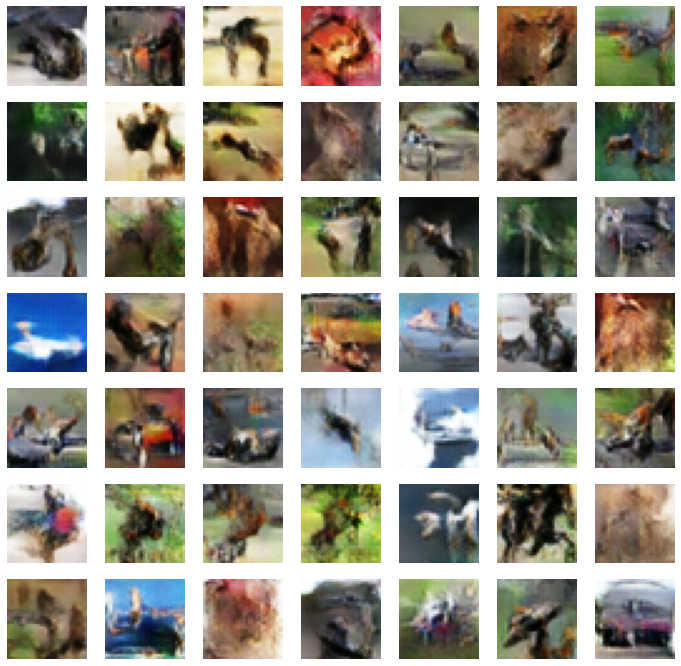

>321, 1/39, d1=0.521, d2=0.527 g=1.254
>321, 2/39, d1=0.603, d2=0.519 g=1.277
>321, 3/39, d1=0.581, d2=0.468 g=1.180
>321, 4/39, d1=0.556, d2=0.523 g=1.088
>321, 5/39, d1=0.581, d2=0.616 g=1.074
>321, 6/39, d1=0.528, d2=0.658 g=1.145
>321, 7/39, d1=0.646, d2=0.555 g=1.211
>321, 8/39, d1=0.692, d2=0.490 g=1.195
>321, 9/39, d1=0.668, d2=0.528 g=1.079
>321, 10/39, d1=0.552, d2=0.608 g=0.970
>321, 11/39, d1=0.532, d2=0.684 g=1.021
>321, 12/39, d1=0.561, d2=0.534 g=1.143
>321, 13/39, d1=0.537, d2=0.485 g=1.131
>321, 14/39, d1=0.524, d2=0.499 g=1.053
>321, 15/39, d1=0.626, d2=0.575 g=1.066
>321, 16/39, d1=0.561, d2=0.578 g=1.095
>321, 17/39, d1=0.496, d2=0.623 g=1.087
>321, 18/39, d1=0.486, d2=0.622 g=1.177
>321, 19/39, d1=0.615, d2=0.616 g=1.143
>321, 20/39, d1=0.544, d2=0.629 g=1.208
>321, 21/39, d1=0.583, d2=0.553 g=1.200
>321, 22/39, d1=0.702, d2=0.466 g=1.089
>321, 23/39, d1=0.581, d2=0.519 g=1.222
>321, 24/39, d1=0.608, d2=0.577 g=1.148
>321, 25/39, d1=0.647, d2=0.592 g=1.171
>321, 26/

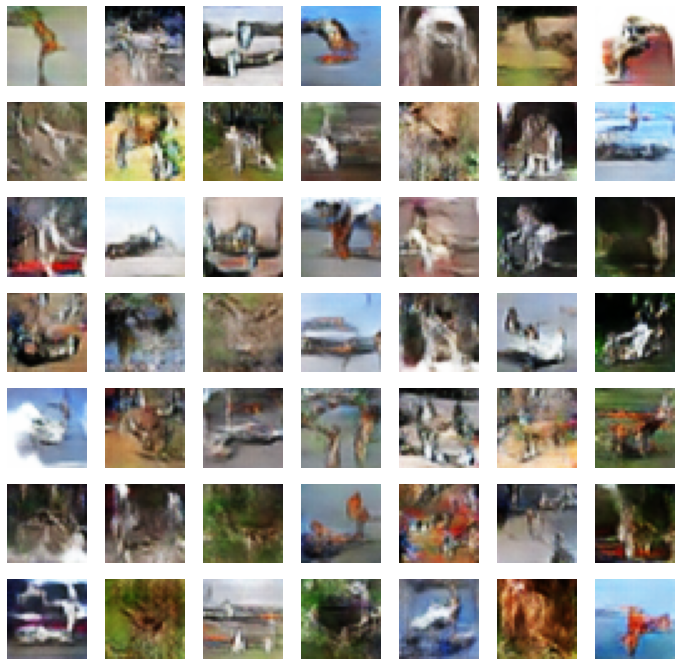

>331, 1/39, d1=0.588, d2=0.517 g=1.233
>331, 2/39, d1=0.532, d2=0.516 g=1.249
>331, 3/39, d1=0.467, d2=0.583 g=1.165
>331, 4/39, d1=0.568, d2=0.615 g=1.204
>331, 5/39, d1=0.625, d2=0.563 g=1.174
>331, 6/39, d1=0.656, d2=0.564 g=1.124
>331, 7/39, d1=0.589, d2=0.458 g=1.100
>331, 8/39, d1=0.562, d2=0.560 g=1.210
>331, 9/39, d1=0.621, d2=0.600 g=1.183
>331, 10/39, d1=0.532, d2=0.625 g=1.166
>331, 11/39, d1=0.600, d2=0.570 g=1.147
>331, 12/39, d1=0.594, d2=0.593 g=1.253
>331, 13/39, d1=0.574, d2=0.526 g=1.192
>331, 14/39, d1=0.674, d2=0.581 g=1.109
>331, 15/39, d1=0.589, d2=0.579 g=1.163
>331, 16/39, d1=0.587, d2=0.552 g=1.153
>331, 17/39, d1=0.547, d2=0.493 g=1.080
>331, 18/39, d1=0.562, d2=0.568 g=1.092
>331, 19/39, d1=0.500, d2=0.587 g=1.131
>331, 20/39, d1=0.549, d2=0.560 g=1.170
>331, 21/39, d1=0.569, d2=0.513 g=1.077
>331, 22/39, d1=0.495, d2=0.528 g=1.076
>331, 23/39, d1=0.488, d2=0.619 g=1.125
>331, 24/39, d1=0.506, d2=0.503 g=1.108
>331, 25/39, d1=0.521, d2=0.491 g=1.197
>331, 26/

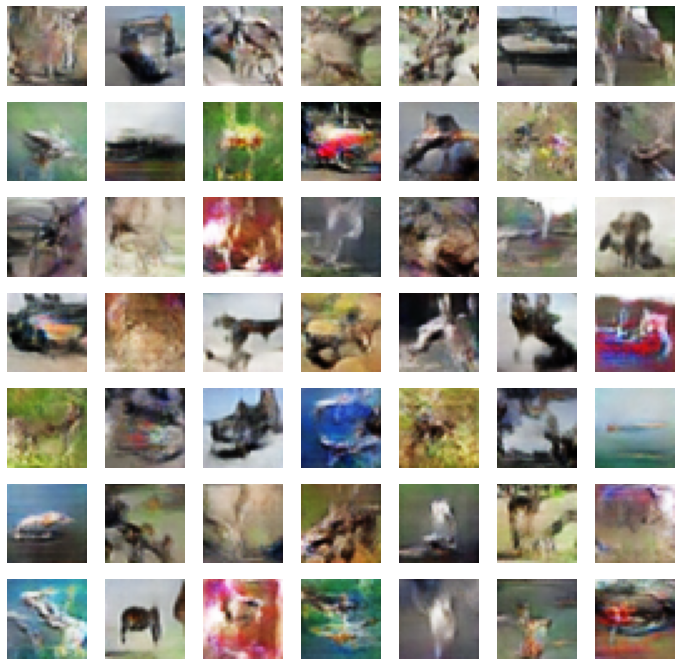

>341, 1/39, d1=0.644, d2=0.561 g=1.084
>341, 2/39, d1=0.583, d2=0.537 g=1.225
>341, 3/39, d1=0.561, d2=0.605 g=1.181
>341, 4/39, d1=0.588, d2=0.534 g=1.094
>341, 5/39, d1=0.515, d2=0.489 g=1.039
>341, 6/39, d1=0.429, d2=0.493 g=1.177
>341, 7/39, d1=0.540, d2=0.635 g=1.137
>341, 8/39, d1=0.425, d2=0.506 g=1.206
>341, 9/39, d1=0.504, d2=0.473 g=1.209
>341, 10/39, d1=0.545, d2=0.578 g=1.189
>341, 11/39, d1=0.599, d2=0.543 g=1.151
>341, 12/39, d1=0.630, d2=0.488 g=1.141
>341, 13/39, d1=0.570, d2=0.532 g=1.177
>341, 14/39, d1=0.475, d2=0.569 g=1.101
>341, 15/39, d1=0.477, d2=0.484 g=1.153
>341, 16/39, d1=0.504, d2=0.563 g=1.154
>341, 17/39, d1=0.557, d2=0.490 g=1.162
>341, 18/39, d1=0.532, d2=0.497 g=1.212
>341, 19/39, d1=0.495, d2=0.465 g=1.111
>341, 20/39, d1=0.450, d2=0.597 g=1.122
>341, 21/39, d1=0.564, d2=0.551 g=1.116
>341, 22/39, d1=0.507, d2=0.580 g=1.356
>341, 23/39, d1=0.529, d2=0.459 g=1.387
>341, 24/39, d1=0.541, d2=0.509 g=1.318
>341, 25/39, d1=0.613, d2=0.399 g=1.273
>341, 26/

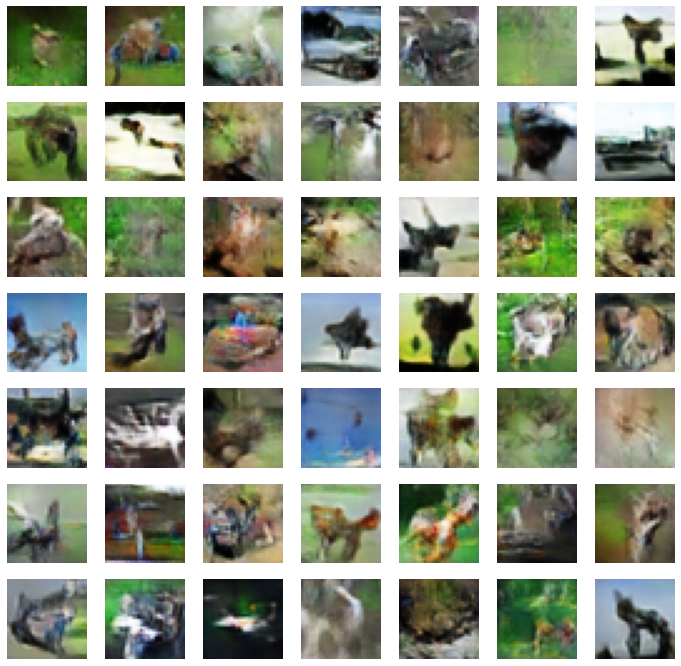

>351, 1/39, d1=0.651, d2=0.525 g=1.142
>351, 2/39, d1=0.587, d2=0.579 g=1.163
>351, 3/39, d1=0.609, d2=0.532 g=1.212
>351, 4/39, d1=0.465, d2=0.592 g=1.083
>351, 5/39, d1=0.481, d2=0.617 g=1.295
>351, 6/39, d1=0.502, d2=0.475 g=1.135
>351, 7/39, d1=0.503, d2=0.557 g=1.266
>351, 8/39, d1=0.591, d2=0.519 g=1.363
>351, 9/39, d1=0.611, d2=0.421 g=1.351
>351, 10/39, d1=0.503, d2=0.557 g=1.308
>351, 11/39, d1=0.611, d2=0.485 g=1.323
>351, 12/39, d1=0.522, d2=0.499 g=1.306
>351, 13/39, d1=0.589, d2=0.517 g=1.242
>351, 14/39, d1=0.509, d2=0.500 g=1.276
>351, 15/39, d1=0.469, d2=0.517 g=1.263
>351, 16/39, d1=0.487, d2=0.519 g=1.218
>351, 17/39, d1=0.504, d2=0.625 g=1.189
>351, 18/39, d1=0.502, d2=0.555 g=1.131
>351, 19/39, d1=0.680, d2=0.567 g=1.195
>351, 20/39, d1=0.523, d2=0.589 g=1.198
>351, 21/39, d1=0.619, d2=0.472 g=1.238
>351, 22/39, d1=0.496, d2=0.539 g=1.171
>351, 23/39, d1=0.507, d2=0.538 g=1.250
>351, 24/39, d1=0.698, d2=0.560 g=1.272
>351, 25/39, d1=0.570, d2=0.556 g=1.095
>351, 26/

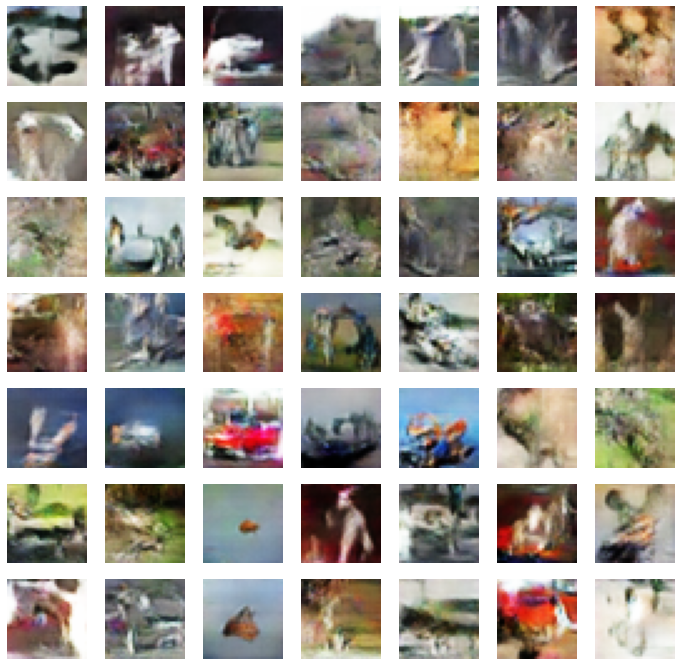

>361, 1/39, d1=0.566, d2=0.498 g=1.154
>361, 2/39, d1=0.494, d2=0.695 g=1.179
>361, 3/39, d1=0.479, d2=0.583 g=1.267
>361, 4/39, d1=0.568, d2=0.511 g=1.337
>361, 5/39, d1=0.612, d2=0.544 g=1.200
>361, 6/39, d1=0.509, d2=0.506 g=1.262
>361, 7/39, d1=0.509, d2=0.520 g=1.336
>361, 8/39, d1=0.589, d2=0.476 g=1.355
>361, 9/39, d1=0.518, d2=0.504 g=1.235
>361, 10/39, d1=0.529, d2=0.508 g=1.350
>361, 11/39, d1=0.605, d2=0.478 g=1.203
>361, 12/39, d1=0.465, d2=0.560 g=1.216
>361, 13/39, d1=0.544, d2=0.560 g=1.214
>361, 14/39, d1=0.523, d2=0.570 g=1.226
>361, 15/39, d1=0.506, d2=0.397 g=1.294
>361, 16/39, d1=0.555, d2=0.522 g=1.172
>361, 17/39, d1=0.520, d2=0.501 g=1.278
>361, 18/39, d1=0.525, d2=0.490 g=1.226
>361, 19/39, d1=0.548, d2=0.556 g=1.274
>361, 20/39, d1=0.537, d2=0.563 g=1.262
>361, 21/39, d1=0.472, d2=0.518 g=1.305
>361, 22/39, d1=0.583, d2=0.524 g=1.250
>361, 23/39, d1=0.616, d2=0.581 g=1.177
>361, 24/39, d1=0.505, d2=0.604 g=1.243
>361, 25/39, d1=0.561, d2=0.528 g=1.250
>361, 26/

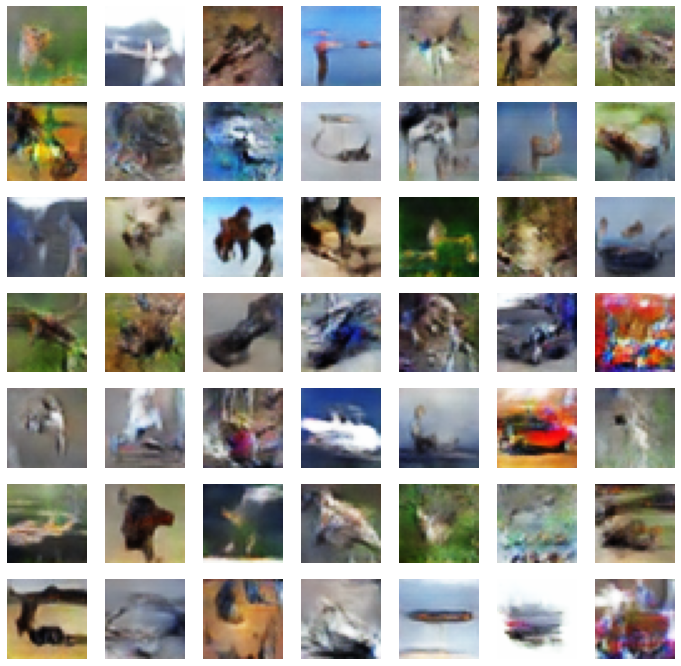

>371, 1/39, d1=0.603, d2=0.680 g=1.315
>371, 2/39, d1=0.567, d2=0.548 g=1.229
>371, 3/39, d1=0.581, d2=0.431 g=1.400
>371, 4/39, d1=0.537, d2=0.536 g=1.146
>371, 5/39, d1=0.600, d2=0.515 g=1.291
>371, 6/39, d1=0.485, d2=0.541 g=1.225
>371, 7/39, d1=0.597, d2=0.544 g=1.332
>371, 8/39, d1=0.521, d2=0.509 g=1.255
>371, 9/39, d1=0.521, d2=0.499 g=1.277
>371, 10/39, d1=0.678, d2=0.563 g=1.212
>371, 11/39, d1=0.521, d2=0.487 g=1.304
>371, 12/39, d1=0.546, d2=0.564 g=1.206
>371, 13/39, d1=0.616, d2=0.574 g=1.231
>371, 14/39, d1=0.518, d2=0.529 g=1.224
>371, 15/39, d1=0.540, d2=0.434 g=1.215
>371, 16/39, d1=0.501, d2=0.548 g=1.210
>371, 17/39, d1=0.482, d2=0.484 g=1.205
>371, 18/39, d1=0.518, d2=0.514 g=1.259
>371, 19/39, d1=0.554, d2=0.617 g=1.264
>371, 20/39, d1=0.560, d2=0.513 g=1.295
>371, 21/39, d1=0.526, d2=0.462 g=1.301
>371, 22/39, d1=0.470, d2=0.459 g=1.265
>371, 23/39, d1=0.497, d2=0.526 g=1.200
>371, 24/39, d1=0.471, d2=0.449 g=1.282
>371, 25/39, d1=0.480, d2=0.609 g=1.303
>371, 26/

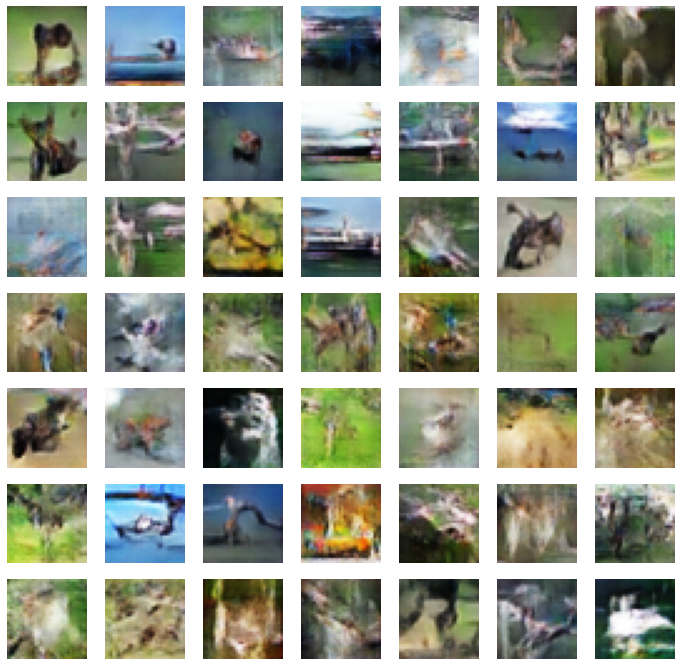

>381, 1/39, d1=0.441, d2=0.526 g=1.353
>381, 2/39, d1=0.544, d2=0.486 g=1.323
>381, 3/39, d1=0.531, d2=0.460 g=1.342
>381, 4/39, d1=0.445, d2=0.453 g=1.277
>381, 5/39, d1=0.413, d2=0.529 g=1.296
>381, 6/39, d1=0.471, d2=0.606 g=1.335
>381, 7/39, d1=0.675, d2=0.409 g=1.289
>381, 8/39, d1=0.580, d2=0.618 g=1.471
>381, 9/39, d1=0.497, d2=0.433 g=1.598
>381, 10/39, d1=0.775, d2=0.425 g=1.401
>381, 11/39, d1=0.568, d2=0.452 g=1.324
>381, 12/39, d1=0.469, d2=0.577 g=1.426
>381, 13/39, d1=0.519, d2=0.487 g=1.293
>381, 14/39, d1=0.480, d2=0.591 g=1.124
>381, 15/39, d1=0.539, d2=0.576 g=1.240
>381, 16/39, d1=0.463, d2=0.543 g=1.330
>381, 17/39, d1=0.613, d2=0.553 g=1.283
>381, 18/39, d1=0.620, d2=0.519 g=1.313
>381, 19/39, d1=0.580, d2=0.563 g=1.358
>381, 20/39, d1=0.466, d2=0.573 g=1.298
>381, 21/39, d1=0.548, d2=0.399 g=1.336
>381, 22/39, d1=0.499, d2=0.647 g=1.204
>381, 23/39, d1=0.520, d2=0.560 g=1.253
>381, 24/39, d1=0.471, d2=0.500 g=1.354
>381, 25/39, d1=0.642, d2=0.465 g=1.291
>381, 26/

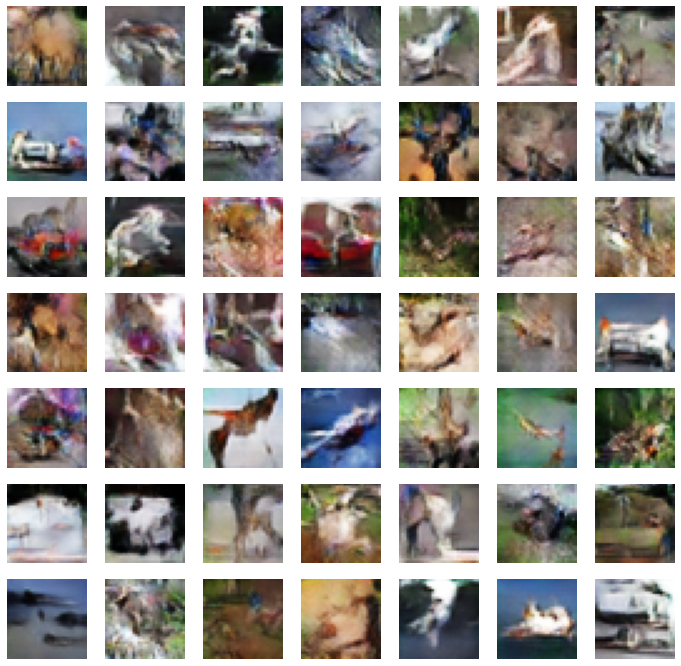

>391, 1/39, d1=0.532, d2=0.512 g=1.331
>391, 2/39, d1=0.386, d2=0.553 g=1.319
>391, 3/39, d1=0.576, d2=0.572 g=1.395
>391, 4/39, d1=0.556, d2=0.455 g=1.345
>391, 5/39, d1=0.594, d2=0.574 g=1.218
>391, 6/39, d1=0.495, d2=0.531 g=1.381
>391, 7/39, d1=0.525, d2=0.404 g=1.341
>391, 8/39, d1=0.548, d2=0.521 g=1.424
>391, 9/39, d1=0.444, d2=0.474 g=1.426
>391, 10/39, d1=0.509, d2=0.502 g=1.422
>391, 11/39, d1=0.467, d2=0.392 g=1.370
>391, 12/39, d1=0.493, d2=0.549 g=1.437
>391, 13/39, d1=0.460, d2=0.482 g=1.445
>391, 14/39, d1=0.509, d2=0.518 g=1.411
>391, 15/39, d1=0.609, d2=0.451 g=1.325
>391, 16/39, d1=0.504, d2=0.450 g=1.381
>391, 17/39, d1=0.513, d2=0.495 g=1.356
>391, 18/39, d1=0.431, d2=0.515 g=1.316
>391, 19/39, d1=0.520, d2=0.479 g=1.467
>391, 20/39, d1=0.492, d2=0.412 g=1.397
>391, 21/39, d1=0.492, d2=0.528 g=1.478
>391, 22/39, d1=0.521, d2=0.424 g=1.249
>391, 23/39, d1=0.503, d2=0.504 g=1.458
>391, 24/39, d1=0.584, d2=0.577 g=1.367
>391, 25/39, d1=0.534, d2=0.483 g=1.439
>391, 26/

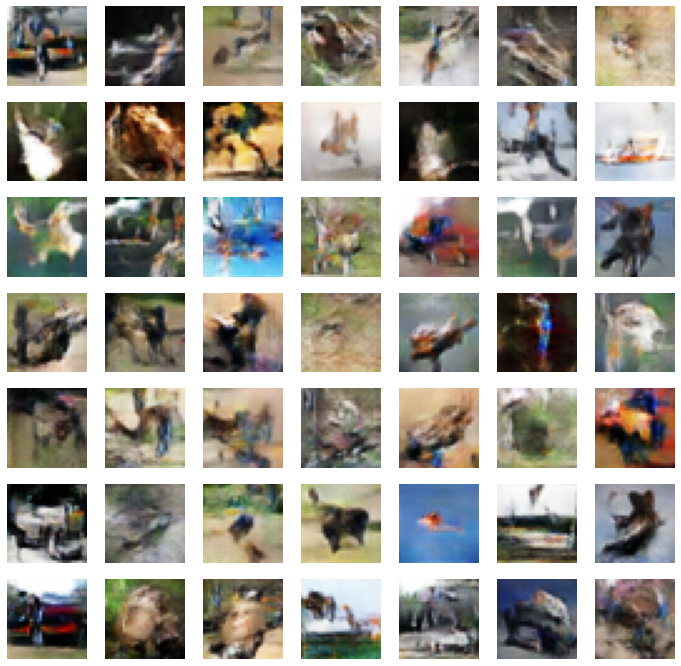

>401, 1/39, d1=0.517, d2=0.573 g=1.322
>401, 2/39, d1=0.436, d2=0.499 g=1.332
>401, 3/39, d1=0.582, d2=0.430 g=1.450
>401, 4/39, d1=0.417, d2=0.418 g=1.232
>401, 5/39, d1=0.433, d2=0.429 g=1.465
>401, 6/39, d1=0.505, d2=0.539 g=1.239
>401, 7/39, d1=0.492, d2=0.453 g=1.406
>401, 8/39, d1=0.528, d2=0.487 g=1.457
>401, 9/39, d1=0.389, d2=0.493 g=1.373
>401, 10/39, d1=0.456, d2=0.430 g=1.298
>401, 11/39, d1=0.411, d2=0.522 g=1.314
>401, 12/39, d1=0.557, d2=0.513 g=1.407
>401, 13/39, d1=0.621, d2=0.511 g=1.275
>401, 14/39, d1=0.546, d2=0.485 g=1.305
>401, 15/39, d1=0.553, d2=0.516 g=1.400
>401, 16/39, d1=0.435, d2=0.530 g=1.320
>401, 17/39, d1=0.476, d2=0.487 g=1.424
>401, 18/39, d1=0.536, d2=0.513 g=1.338
>401, 19/39, d1=0.407, d2=0.624 g=1.330
>401, 20/39, d1=0.655, d2=0.501 g=1.558
>401, 21/39, d1=0.532, d2=0.543 g=1.357
>401, 22/39, d1=0.518, d2=0.466 g=1.360
>401, 23/39, d1=0.569, d2=0.417 g=1.359
>401, 24/39, d1=0.563, d2=0.575 g=1.445
>401, 25/39, d1=0.453, d2=0.482 g=1.311
>401, 26/

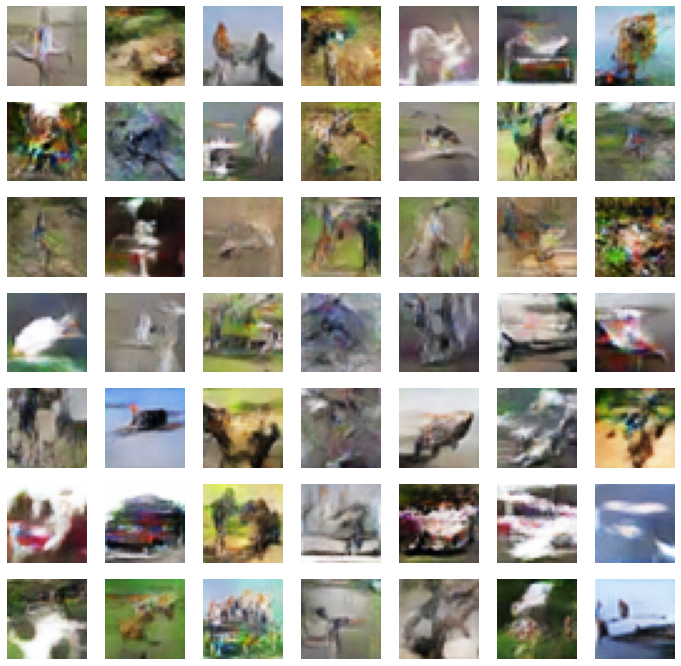

>411, 1/39, d1=0.418, d2=0.493 g=1.312
>411, 2/39, d1=0.428, d2=0.494 g=1.365
>411, 3/39, d1=0.528, d2=0.432 g=1.296
>411, 4/39, d1=0.461, d2=0.590 g=1.503
>411, 5/39, d1=0.582, d2=0.447 g=1.380
>411, 6/39, d1=0.555, d2=0.524 g=1.339
>411, 7/39, d1=0.479, d2=0.507 g=1.352
>411, 8/39, d1=0.494, d2=0.493 g=1.423
>411, 9/39, d1=0.603, d2=0.455 g=1.479
>411, 10/39, d1=0.497, d2=0.549 g=1.403
>411, 11/39, d1=0.386, d2=0.422 g=1.491
>411, 12/39, d1=0.610, d2=0.471 g=1.444
>411, 13/39, d1=0.436, d2=0.434 g=1.555
>411, 14/39, d1=0.480, d2=0.407 g=1.324
>411, 15/39, d1=0.456, d2=0.578 g=1.401
>411, 16/39, d1=0.408, d2=0.554 g=1.476
>411, 17/39, d1=0.594, d2=0.465 g=1.505
>411, 18/39, d1=0.606, d2=0.495 g=1.582
>411, 19/39, d1=0.527, d2=0.509 g=1.416
>411, 20/39, d1=0.452, d2=0.498 g=1.538
>411, 21/39, d1=0.587, d2=0.397 g=1.320
>411, 22/39, d1=0.482, d2=0.481 g=1.402
>411, 23/39, d1=0.431, d2=0.389 g=1.389
>411, 24/39, d1=0.418, d2=0.402 g=1.479
>411, 25/39, d1=0.482, d2=0.613 g=1.481
>411, 26/

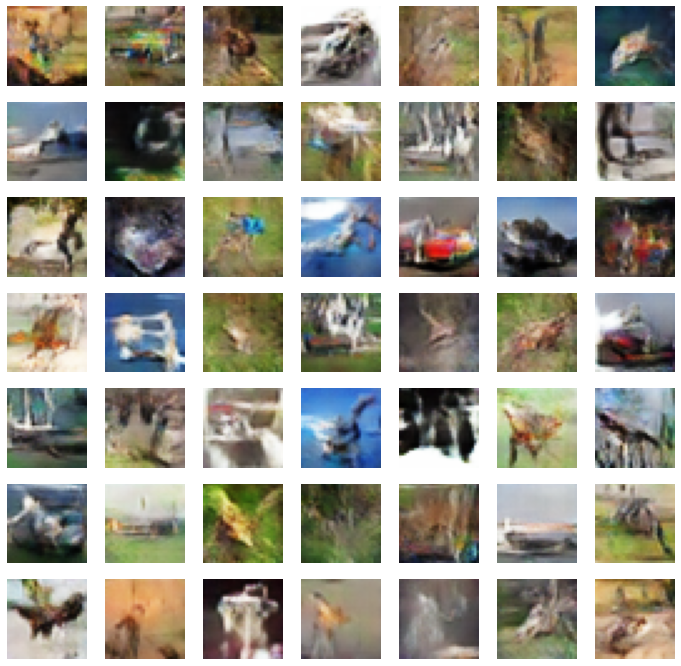

>421, 1/39, d1=0.445, d2=0.666 g=1.360
>421, 2/39, d1=0.583, d2=0.387 g=1.450
>421, 3/39, d1=0.439, d2=0.446 g=1.415
>421, 4/39, d1=0.513, d2=0.393 g=1.508
>421, 5/39, d1=0.482, d2=0.530 g=1.479
>421, 6/39, d1=0.524, d2=0.475 g=1.498
>421, 7/39, d1=0.486, d2=0.486 g=1.483
>421, 8/39, d1=0.558, d2=0.485 g=1.369
>421, 9/39, d1=0.562, d2=0.500 g=1.229
>421, 10/39, d1=0.510, d2=0.671 g=1.318
>421, 11/39, d1=0.455, d2=0.537 g=1.333
>421, 12/39, d1=0.658, d2=0.377 g=1.377
>421, 13/39, d1=0.504, d2=0.539 g=1.279
>421, 14/39, d1=0.397, d2=0.490 g=1.444
>421, 15/39, d1=0.466, d2=0.540 g=1.456
>421, 16/39, d1=0.564, d2=0.554 g=1.374
>421, 17/39, d1=0.512, d2=0.424 g=1.508
>421, 18/39, d1=0.494, d2=0.527 g=1.340
>421, 19/39, d1=0.354, d2=0.478 g=1.407
>421, 20/39, d1=0.575, d2=0.363 g=1.350
>421, 21/39, d1=0.350, d2=0.445 g=1.511
>421, 22/39, d1=0.446, d2=0.490 g=1.460
>421, 23/39, d1=0.556, d2=0.408 g=1.339
>421, 24/39, d1=0.419, d2=0.470 g=1.371
>421, 25/39, d1=0.546, d2=0.529 g=1.379
>421, 26/

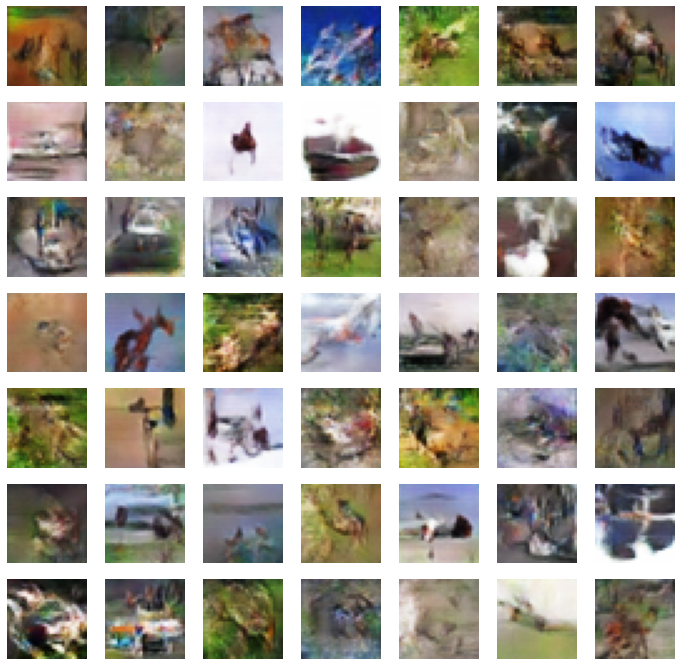

>431, 1/39, d1=0.443, d2=0.418 g=1.601
>431, 2/39, d1=0.573, d2=0.391 g=1.458
>431, 3/39, d1=0.413, d2=0.514 g=1.489
>431, 4/39, d1=0.422, d2=0.451 g=1.525
>431, 5/39, d1=0.504, d2=0.558 g=1.446
>431, 6/39, d1=0.493, d2=0.434 g=1.432
>431, 7/39, d1=0.532, d2=0.454 g=1.495
>431, 8/39, d1=0.547, d2=0.443 g=1.435
>431, 9/39, d1=0.497, d2=0.497 g=1.532
>431, 10/39, d1=0.494, d2=0.367 g=1.477
>431, 11/39, d1=0.456, d2=0.496 g=1.375
>431, 12/39, d1=0.399, d2=0.470 g=1.447
>431, 13/39, d1=0.404, d2=0.482 g=1.430
>431, 14/39, d1=0.522, d2=0.478 g=1.327
>431, 15/39, d1=0.360, d2=0.506 g=1.566
>431, 16/39, d1=0.329, d2=0.556 g=1.439
>431, 17/39, d1=0.499, d2=0.334 g=1.545
>431, 18/39, d1=0.669, d2=0.413 g=1.499
>431, 19/39, d1=0.495, d2=0.431 g=1.373
>431, 20/39, d1=0.358, d2=0.454 g=1.337
>431, 21/39, d1=0.470, d2=0.415 g=1.485
>431, 22/39, d1=0.503, d2=0.616 g=1.568
>431, 23/39, d1=0.556, d2=0.376 g=1.458
>431, 24/39, d1=0.412, d2=0.420 g=1.505
>431, 25/39, d1=0.525, d2=0.575 g=1.509
>431, 26/

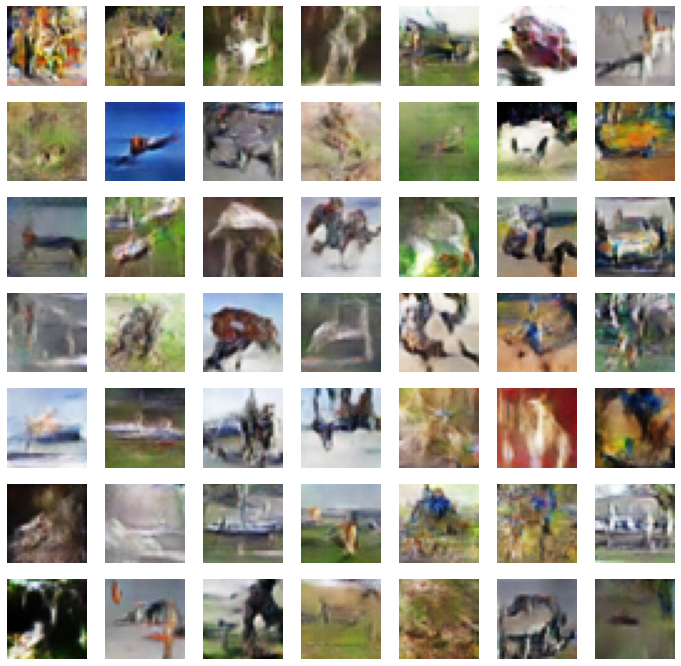

>441, 1/39, d1=0.501, d2=0.389 g=1.426
>441, 2/39, d1=0.462, d2=0.421 g=1.461
>441, 3/39, d1=0.504, d2=0.504 g=1.548
>441, 4/39, d1=0.562, d2=0.406 g=1.481
>441, 5/39, d1=0.498, d2=0.588 g=1.562
>441, 6/39, d1=0.516, d2=0.365 g=1.562
>441, 7/39, d1=0.484, d2=0.418 g=1.539
>441, 8/39, d1=0.449, d2=0.454 g=1.458
>441, 9/39, d1=0.440, d2=0.441 g=1.522
>441, 10/39, d1=0.486, d2=0.410 g=1.521
>441, 11/39, d1=0.409, d2=0.475 g=1.709
>441, 12/39, d1=0.370, d2=0.391 g=1.718
>441, 13/39, d1=0.555, d2=0.431 g=1.509
>441, 14/39, d1=0.445, d2=0.613 g=1.585
>441, 15/39, d1=0.466, d2=0.390 g=1.647
>441, 16/39, d1=0.404, d2=0.320 g=1.581
>441, 17/39, d1=0.352, d2=0.466 g=1.462
>441, 18/39, d1=0.414, d2=0.397 g=1.496
>441, 19/39, d1=0.341, d2=0.442 g=1.571
>441, 20/39, d1=0.440, d2=0.564 g=1.447
>441, 21/39, d1=0.482, d2=0.433 g=1.505
>441, 22/39, d1=0.343, d2=0.517 g=1.640
>441, 23/39, d1=0.430, d2=0.525 g=1.546
>441, 24/39, d1=0.517, d2=0.405 g=1.621
>441, 25/39, d1=0.542, d2=0.526 g=1.709
>441, 26/

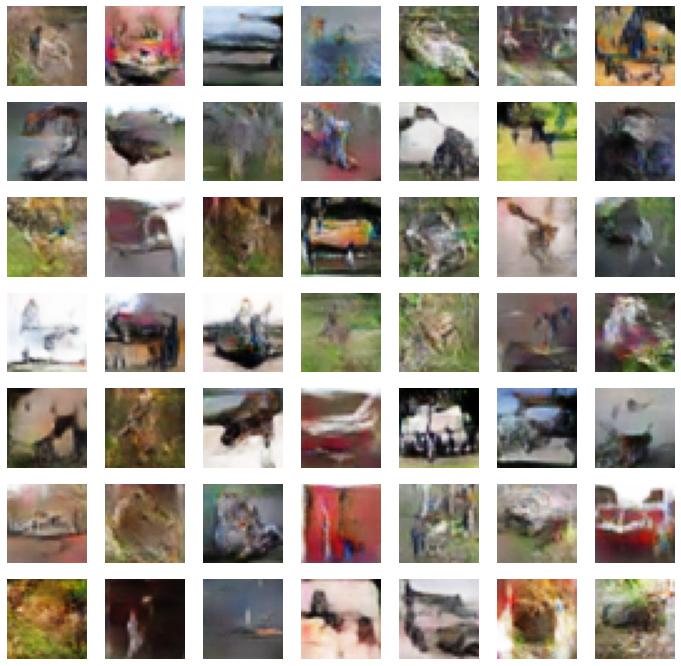

>451, 1/39, d1=0.364, d2=0.448 g=1.622
>451, 2/39, d1=0.426, d2=0.380 g=1.561
>451, 3/39, d1=0.398, d2=0.453 g=1.459
>451, 4/39, d1=0.525, d2=0.381 g=1.726
>451, 5/39, d1=0.337, d2=0.415 g=1.834
>451, 6/39, d1=0.455, d2=0.515 g=1.734
>451, 7/39, d1=0.416, d2=0.397 g=1.709
>451, 8/39, d1=0.414, d2=0.444 g=1.589
>451, 9/39, d1=0.589, d2=0.468 g=1.464
>451, 10/39, d1=0.453, d2=0.459 g=1.476
>451, 11/39, d1=0.397, d2=0.518 g=1.545
>451, 12/39, d1=0.441, d2=0.510 g=1.653
>451, 13/39, d1=0.496, d2=0.451 g=1.749
>451, 14/39, d1=0.511, d2=0.487 g=1.652
>451, 15/39, d1=0.535, d2=0.397 g=1.418
>451, 16/39, d1=0.437, d2=0.491 g=1.432
>451, 17/39, d1=0.451, d2=0.450 g=1.461
>451, 18/39, d1=0.557, d2=0.393 g=1.474
>451, 19/39, d1=0.336, d2=0.464 g=1.472
>451, 20/39, d1=0.384, d2=0.422 g=1.495
>451, 21/39, d1=0.376, d2=0.595 g=1.716
>451, 22/39, d1=0.426, d2=0.586 g=1.802
>451, 23/39, d1=0.569, d2=0.282 g=1.773
>451, 24/39, d1=0.451, d2=0.463 g=1.726
>451, 25/39, d1=0.470, d2=0.503 g=1.598
>451, 26/

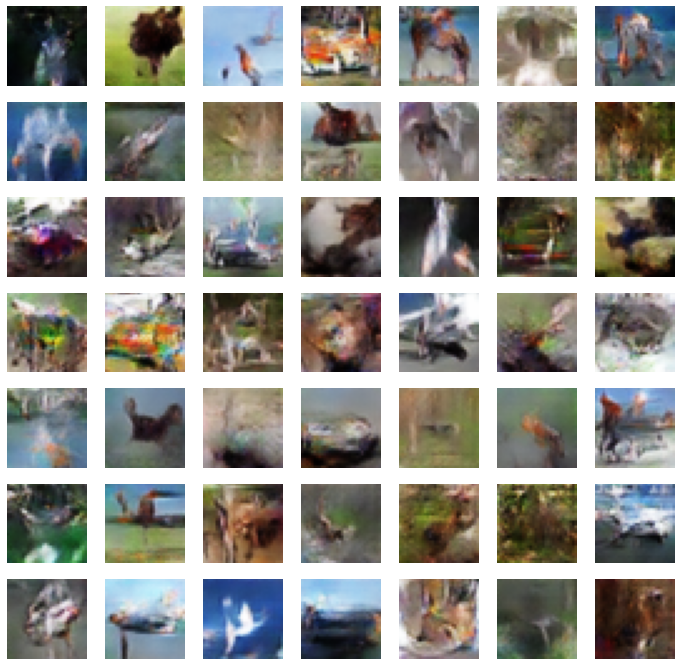

>461, 1/39, d1=0.430, d2=0.335 g=1.640
>461, 2/39, d1=0.424, d2=0.357 g=1.461
>461, 3/39, d1=0.394, d2=0.454 g=1.545
>461, 4/39, d1=0.425, d2=0.423 g=1.703
>461, 5/39, d1=0.361, d2=0.510 g=1.866
>461, 6/39, d1=0.488, d2=0.360 g=1.615
>461, 7/39, d1=0.382, d2=0.422 g=1.720
>461, 8/39, d1=0.408, d2=0.411 g=1.639
>461, 9/39, d1=0.531, d2=0.524 g=1.585
>461, 10/39, d1=0.441, d2=0.424 g=1.609
>461, 11/39, d1=0.466, d2=0.507 g=1.554
>461, 12/39, d1=0.482, d2=0.379 g=1.543
>461, 13/39, d1=0.553, d2=0.351 g=1.557
>461, 14/39, d1=0.300, d2=0.590 g=1.617
>461, 15/39, d1=0.536, d2=0.422 g=1.635
>461, 16/39, d1=0.527, d2=0.462 g=1.764
>461, 17/39, d1=0.619, d2=0.340 g=1.693
>461, 18/39, d1=0.402, d2=0.450 g=1.593
>461, 19/39, d1=0.436, d2=0.439 g=1.596
>461, 20/39, d1=0.402, d2=0.606 g=1.489
>461, 21/39, d1=0.526, d2=0.389 g=1.632
>461, 22/39, d1=0.473, d2=0.416 g=1.531
>461, 23/39, d1=0.468, d2=0.333 g=1.587
>461, 24/39, d1=0.537, d2=0.618 g=1.528
>461, 25/39, d1=0.386, d2=0.437 g=1.591
>461, 26/

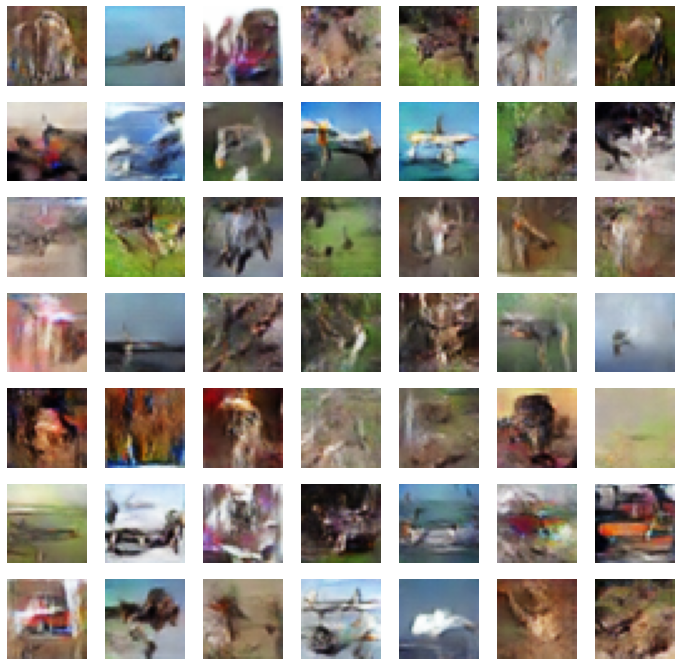

>471, 1/39, d1=0.465, d2=0.395 g=1.693
>471, 2/39, d1=0.449, d2=0.463 g=1.536
>471, 3/39, d1=0.383, d2=0.421 g=1.650
>471, 4/39, d1=0.334, d2=0.416 g=1.810
>471, 5/39, d1=0.368, d2=0.359 g=1.651
>471, 6/39, d1=0.497, d2=0.558 g=1.677
>471, 7/39, d1=0.453, d2=0.609 g=1.769
>471, 8/39, d1=0.342, d2=0.417 g=1.942
>471, 9/39, d1=0.606, d2=0.500 g=1.833
>471, 10/39, d1=0.504, d2=0.358 g=1.689
>471, 11/39, d1=0.383, d2=0.453 g=1.564
>471, 12/39, d1=0.377, d2=0.484 g=1.587
>471, 13/39, d1=0.583, d2=0.460 g=1.631
>471, 14/39, d1=0.368, d2=0.414 g=1.618
>471, 15/39, d1=0.404, d2=0.399 g=1.711
>471, 16/39, d1=0.417, d2=0.383 g=1.754
>471, 17/39, d1=0.462, d2=0.405 g=1.737
>471, 18/39, d1=0.426, d2=0.526 g=1.593
>471, 19/39, d1=0.390, d2=0.517 g=1.791
>471, 20/39, d1=0.486, d2=0.393 g=1.657
>471, 21/39, d1=0.658, d2=0.586 g=1.659
>471, 22/39, d1=0.480, d2=0.467 g=1.604
>471, 23/39, d1=0.453, d2=0.532 g=1.855
>471, 24/39, d1=0.495, d2=0.372 g=1.666
>471, 25/39, d1=0.475, d2=0.462 g=1.655
>471, 26/

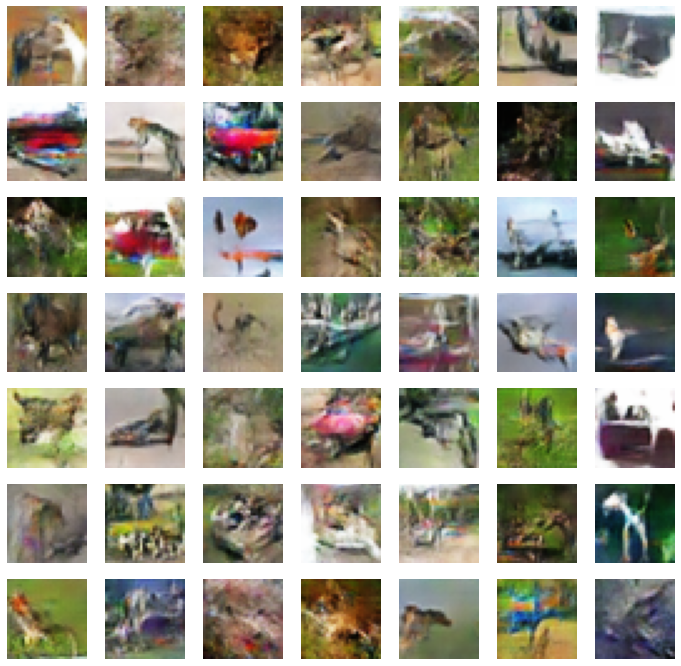

>481, 1/39, d1=0.454, d2=0.340 g=1.696
>481, 2/39, d1=0.418, d2=0.366 g=1.697
>481, 3/39, d1=0.360, d2=0.318 g=1.712
>481, 4/39, d1=0.423, d2=0.363 g=1.694
>481, 5/39, d1=0.544, d2=0.506 g=1.583
>481, 6/39, d1=0.399, d2=0.492 g=1.452
>481, 7/39, d1=0.370, d2=0.511 g=1.638
>481, 8/39, d1=0.388, d2=0.453 g=1.560
>481, 9/39, d1=0.423, d2=0.341 g=1.809
>481, 10/39, d1=0.431, d2=0.464 g=1.671
>481, 11/39, d1=0.333, d2=0.494 g=1.835
>481, 12/39, d1=0.507, d2=0.374 g=1.698
>481, 13/39, d1=0.478, d2=0.385 g=1.796
>481, 14/39, d1=0.419, d2=0.503 g=1.613
>481, 15/39, d1=0.359, d2=0.423 g=1.759
>481, 16/39, d1=0.388, d2=0.399 g=1.774
>481, 17/39, d1=0.443, d2=0.340 g=1.634
>481, 18/39, d1=0.338, d2=0.442 g=1.670
>481, 19/39, d1=0.502, d2=0.417 g=1.864
>481, 20/39, d1=0.468, d2=0.350 g=1.714
>481, 21/39, d1=0.422, d2=0.625 g=1.587
>481, 22/39, d1=0.416, d2=0.398 g=1.701
>481, 23/39, d1=0.388, d2=0.450 g=1.957
>481, 24/39, d1=0.471, d2=0.317 g=1.838
>481, 25/39, d1=0.314, d2=0.339 g=1.716
>481, 26/

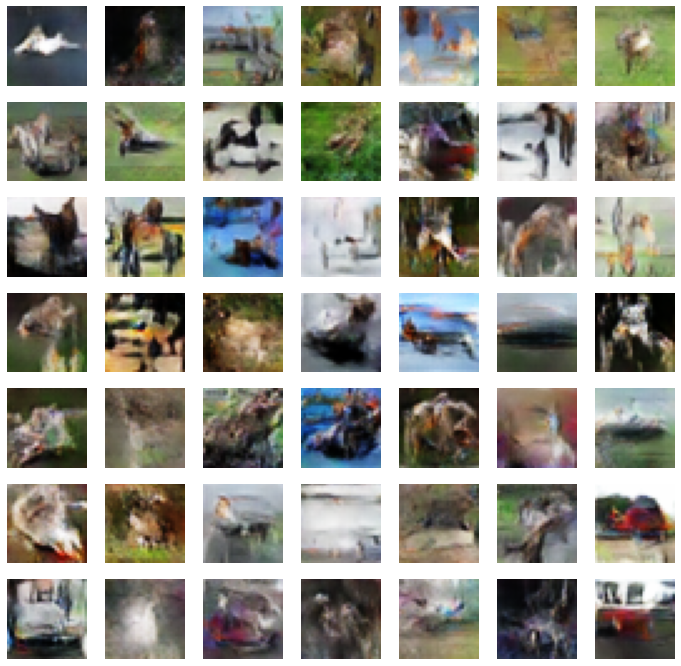

>491, 1/39, d1=0.453, d2=0.354 g=1.795
>491, 2/39, d1=0.355, d2=0.492 g=1.826
>491, 3/39, d1=0.432, d2=0.303 g=1.707
>491, 4/39, d1=0.419, d2=0.370 g=1.747
>491, 5/39, d1=0.369, d2=0.464 g=1.880
>491, 6/39, d1=0.508, d2=0.387 g=1.748
>491, 7/39, d1=0.364, d2=0.426 g=1.716
>491, 8/39, d1=0.393, d2=0.494 g=1.889
>491, 9/39, d1=0.541, d2=0.367 g=2.057
>491, 10/39, d1=0.369, d2=0.435 g=1.774
>491, 11/39, d1=0.543, d2=0.388 g=1.717
>491, 12/39, d1=0.397, d2=0.470 g=1.714
>491, 13/39, d1=0.379, d2=0.307 g=1.514
>491, 14/39, d1=0.456, d2=0.455 g=1.512
>491, 15/39, d1=0.402, d2=0.545 g=1.799
>491, 16/39, d1=0.428, d2=0.301 g=1.804
>491, 17/39, d1=0.539, d2=0.337 g=1.785
>491, 18/39, d1=0.387, d2=0.458 g=1.698
>491, 19/39, d1=0.421, d2=0.441 g=1.683
>491, 20/39, d1=0.465, d2=0.471 g=1.703
>491, 21/39, d1=0.358, d2=0.422 g=1.656
>491, 22/39, d1=0.483, d2=0.348 g=1.777
>491, 23/39, d1=0.425, d2=0.365 g=1.660
>491, 24/39, d1=0.427, d2=0.524 g=1.747
>491, 25/39, d1=0.546, d2=0.433 g=1.595
>491, 26/

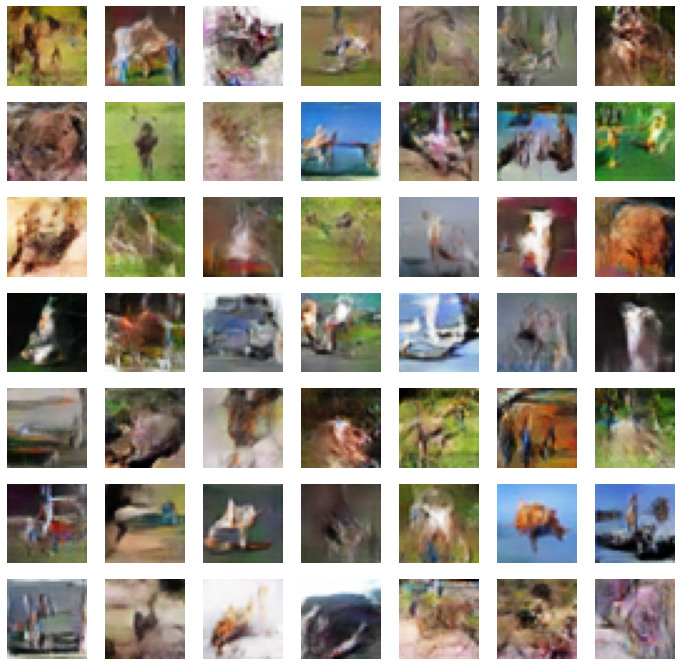

In [ ]:
latent_dim = 100                                     # Give the input length of the generator model
d_model = define_discriminator()                     # Create the discriminator
g_model = define_generator(latent_dim)               # Create the generator
gan_model = define_gan(g_model, d_model)             # Create the gan
dataset = load_real_samples()                        # Load real images
train(g_model, d_model, gan_model, dataset, latent_dim) # Train model using the parameters

# Generate some fake images using the Generator

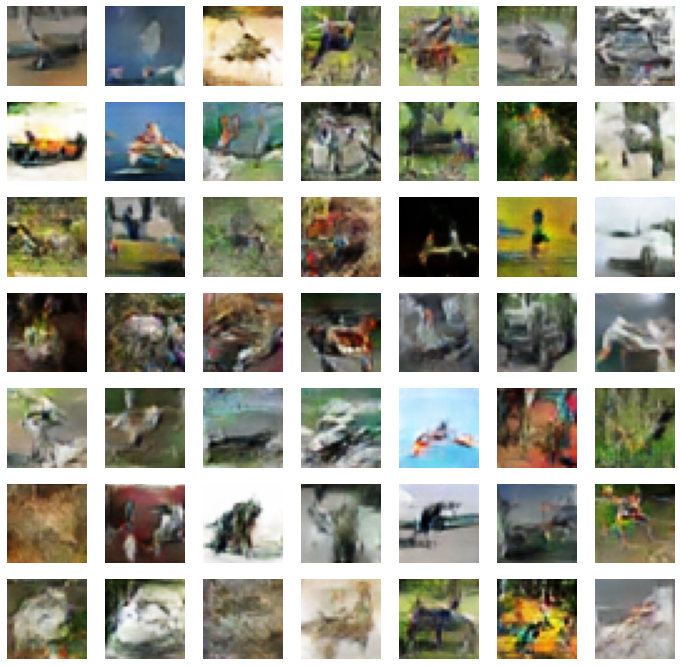

In [ ]:
model = keras.models.load_model('generator_model_490.h5') # Load model
latent_points = generate_latent_points(100, 50)           # Generate input of 50 samples for generator
X = model.predict(latent_points)                          # Generate fake images
plot_generate(X, 7)                                       # Plot the results